In [ ]:
#

In [2]:
import os

import matplotlib.pyplot as plt

from PIL import Image

from torchvision import transforms

from torchvision.datasets import ImageFolder

from torch.utils.data import DataLoader

import cv2

In [3]:
# Define the root directory of the dataset

dataset_root = "/kaggle/input/mri-dataset/Dataset_MRI"



# Define subdirectories for training, validation, and testing data

training_path = os.path.join(dataset_root, 'train')  # Path to training data

validation_path = os.path.join(dataset_root, 'val')  # Path to validation data

testing_path = os.path.join(dataset_root, 'test')    # Path to testing data



# Display available classes in the training directory

print("Available classes in the training dataset:")

print(os.listdir(training_path))  # List folders representing class names



# Display available classes in the validation directory

print("\nAvailable classes in the validation dataset:")

print(os.listdir(validation_path))  # List folders representing class names



# Display available classes in the testing directory

print("\nAvailable classes in the testing dataset:")

print(os.listdir(testing_path))  # List folders representing class names

Available classes in the training dataset:
['Benign', 'Malignant']

Available classes in the validation dataset:
['Benign', 'Malignant']

Available classes in the testing dataset:
['Benign', 'Malignant']


In [4]:
"""

Script for Exploring and Summarizing a Breast Cancer Image Dataset



This script performs the following:

1. Defines paths to the dataset directories (training, validation, and testing).

2. Displays the available classes in each dataset.

3. Provides a utility function to count images in each class for the specified directory.

"""



import os

import matplotlib.pyplot as plt

from PIL import Image



# Utility function to count the number of images per class in a directory

def count_images(directory):

    """

    Counts the number of images in each class folder within the given directory.



    Args:

        directory (str): Path to the directory containing class folders.



    Returns:

        dict: A dictionary with class names as keys and image counts as values.

    """

    class_counts = {}

    for class_name in os.listdir(directory):

        class_path = os.path.join(directory, class_name)

        if os.path.isdir(class_path):  # Ensure it's a folder and not a file

            class_counts[class_name] = len(os.listdir(class_path))

    return class_counts



# Count images in each class for the training set

train_class_counts = count_images(training_path)

print("\nNumber of images in each class (training set):", train_class_counts)


Number of images in each class (training set): {'Benign': 61, 'Malignant': 105}


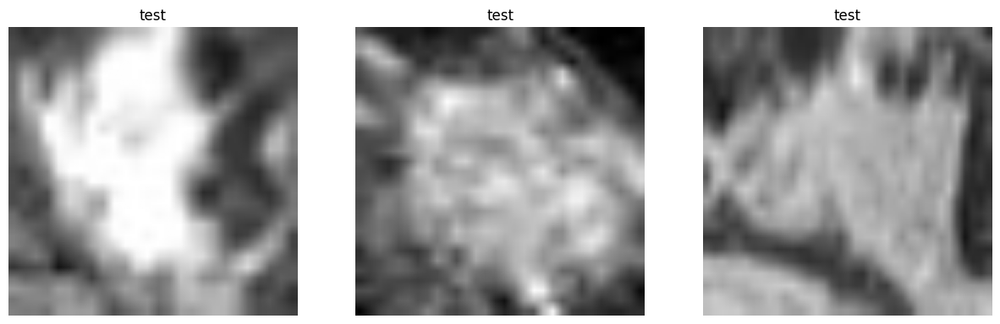

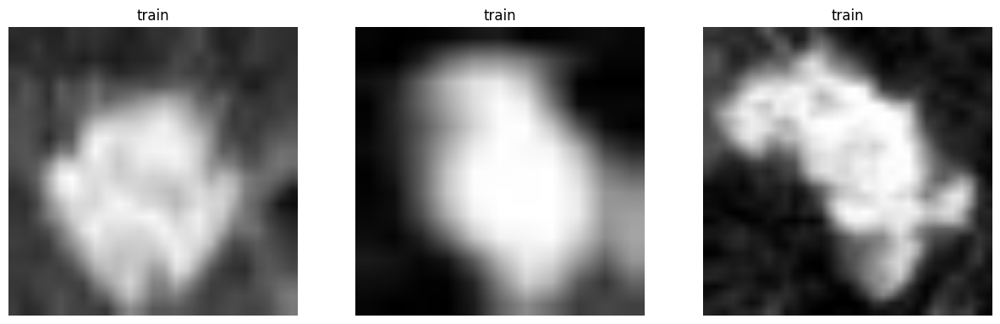

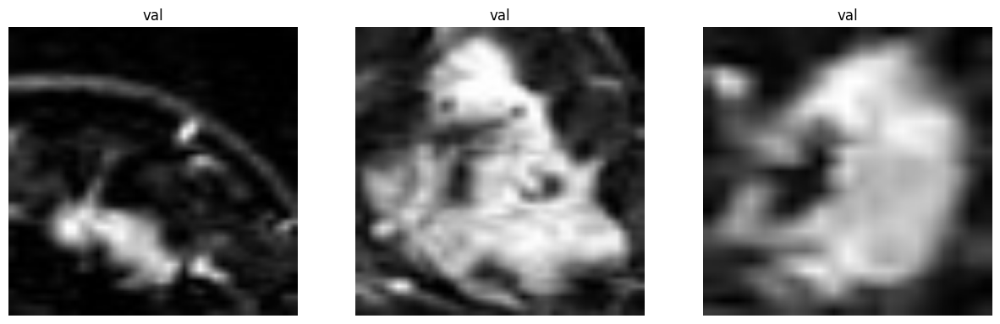

In [6]:
"""

Script to preprocess and visualize a breast cancer image dataset with random sample displays.

"""
import os
import random
import torch
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt



# Specify the root directory of the dataset

dataset_root = '/kaggle/input/mri-dataset/Dataset_MRI'  # Path to the dataset directory



# Define transformations to preprocess the images

image_transforms = transforms.Compose([

    transforms.Resize((224, 224)),  # Resize all images to 224x224 dimensions

    transforms.ToTensor(),         # Convert images to PyTorch tensors

])



# Load the dataset with specified transformations

image_dataset = ImageFolder(root=dataset_root, transform=image_transforms)

class_labels = image_dataset.classes  # Extract class labels from the dataset



# Create a DataLoader for batching and shuffling

data_loader = DataLoader(image_dataset, batch_size=32, shuffle=True)



def display_random_images(dataset, class_labels, num_images=3):

    """

    Display a random selection of images for each class in the dataset.



    Args:

        dataset (ImageFolder): The dataset containing images and labels.

        class_labels (list): List of class names in the dataset.

        num_images (int): Number of images to display per class.

    """

    for class_idx, class_label in enumerate(class_labels):

        # Filter images for the current class

        images_in_class = [dataset[i][0] for i in range(len(dataset)) if dataset[i][1] == class_idx]



        # Randomly select a subset of images to display

        if images_in_class:

            sampled_images = random.sample(images_in_class, min(num_images, len(images_in_class)))

            plt.figure(figsize=(15, 5))

            for img_idx, img in enumerate(sampled_images):

                plt.subplot(1, len(sampled_images), img_idx + 1)

                plt.imshow(img.permute(1, 2, 0).numpy())  # Convert from CxHxW to HxWxC

                plt.title(class_label)  # Display the class name as the title

                plt.axis('off')  # Remove axis for better visualization

            plt.show()



# Display random images for each class

display_random_images(image_dataset, class_labels)


In [ ]:
#

#

In [7]:
"""

Script to define image transformations including resizing, tensor conversion, and normalization.

"""



import torchvision.transforms as transforms

import torch



# Define transformations for preprocessing images

image_preprocessing = transforms.Compose([

    transforms.Resize((224, 224)),  # Resize images to 224x224 pixels

    transforms.ToTensor(),          # Convert images to PyTorch tensors



    # Normalize pixel intensity values to the range based on ImageNet statistics

    transforms.Normalize(

        mean=[0.485, 0.456, 0.406],  # Mean values for the R, G, B channels

        std=[0.229, 0.224, 0.225]    # Standard deviation for the R, G, B channels

    )

])


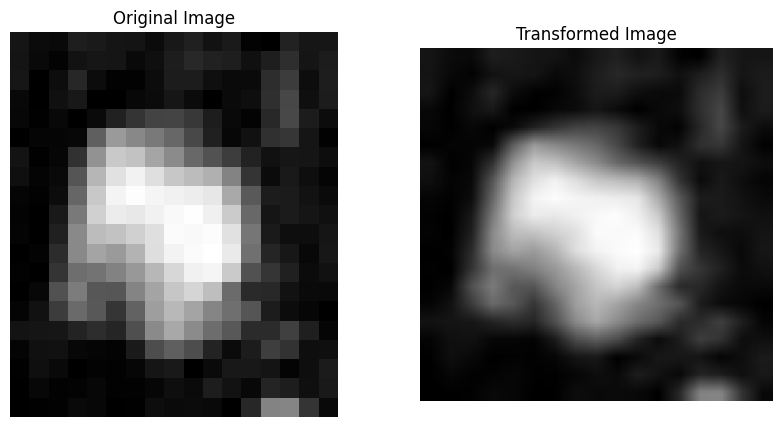

In [10]:
"""

Script to load an image, apply transformations, and visualize the original and transformed images.

"""



import torch

from PIL import Image

import torchvision.transforms as transforms

import matplotlib.pyplot as plt



def display_image_with_transform(image_file_path):

    """

    Load an image from a file path, apply transformations, and display the original and transformed versions.



    Args:

        image_file_path (str): Path to the image file.

    """

    # Load the image and ensure it's in RGB format

    original_image = Image.open(image_file_path).convert("RGB")



    # Define transformations (resizing, tensor conversion, and normalization)

    image_transformations = transforms.Compose([

        transforms.Resize((128, 128)),  # Resize image to 128x128 pixels

        transforms.ToTensor(),          # Convert image to PyTorch tensor

        transforms.Normalize(

            mean=[0.5, 0.5, 0.5],       # Normalize with mean values for R, G, B channels

            std=[0.5, 0.5, 0.5]         # Normalize with standard deviation values for R, G, B channels

        )

    ])



    # Apply transformations to the image

    transformed_tensor = image_transformations(original_image)



    # Define an unnormalization transformation for visualization

    reverse_normalization = transforms.Normalize(

        mean=[-0.5 / 0.5, -0.5 / 0.5, -0.5 / 0.5],  # Reverse mean adjustment

        std=[1 / 0.5, 1 / 0.5, 1 / 0.5]            # Reverse standard deviation scaling

    )

    unnormalized_tensor = reverse_normalization(transformed_tensor)



    # Convert tensors to NumPy arrays for visualization

    original_image_array = transforms.ToTensor()(original_image).permute(1, 2, 0).numpy()

    transformed_image_array = unnormalized_tensor.permute(1, 2, 0).numpy().clip(0, 1)



    # Display the original and transformed images side by side

    figure, axes = plt.subplots(1, 2, figsize=(10, 5))

    axes[0].imshow(original_image_array)

    axes[0].set_title("Original Image")

    axes[0].axis("off")



    axes[1].imshow(transformed_image_array)

    axes[1].set_title("Transformed Image")

    axes[1].axis("off")



    plt.show()



# Example usage: specify the path to an image file

image_file_path = r"/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg"

display_image_with_transform(image_file_path)


In [11]:
"""

Script to define advanced data augmentation techniques for preprocessing images in deep learning pipelines.

"""



import torchvision.transforms as transforms



# Define advanced data augmentation transformations

data_augmentation_transforms = transforms.Compose([

    transforms.Resize((224, 224)),                      # Resize images to 224x224 pixels

    transforms.RandomHorizontalFlip(),                  # Apply random horizontal flipping

    transforms.RandomRotation(10),                     # Rotate images randomly within 10 degrees

    transforms.RandomCrop(224, padding=4),              # Perform random cropping with padding

    transforms.ColorJitter(

        brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2

    ),                                                  # Adjust brightness, contrast, saturation, and hue randomly

    transforms.RandomGrayscale(p=0.1),                  # Convert image to grayscale with a 10% probability

    transforms.RandomPerspective(distortion_scale=0.5, p=0.5),  # Apply random perspective distortion

    transforms.ToTensor(),                              # Convert image to PyTorch tensor

    transforms.Normalize(

        mean=[0.485, 0.456, 0.406],                    # Normalize using ImageNet mean values

        std=[0.229, 0.224, 0.225]                      # Normalize using ImageNet std values

    )

])


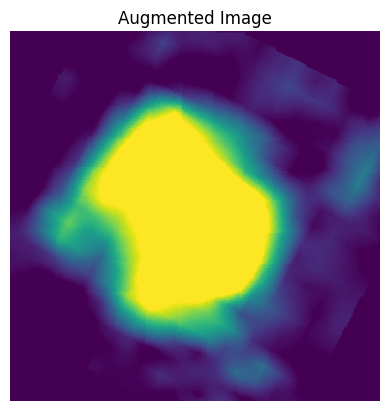

In [12]:
"""

Script to apply augmentation transformations to an image and visualize the augmented output.

"""



import torch

import torchvision.transforms as transforms

from PIL import Image

import matplotlib.pyplot as plt



# Load an example image (update with the correct path to your image file)

image_file_path = r"/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg"

original_image = Image.open(image_file_path)



# Define augmentation transformations for preprocessing

augmentation_pipeline = transforms.Compose([

    transforms.Resize((256, 256)),                     # Resize image to 256x256 pixels

    transforms.RandomHorizontalFlip(),                 # Apply random horizontal flipping

    transforms.RandomRotation(30),                    # Randomly rotate image within 30 degrees

    transforms.ColorJitter(

        brightness=0.5, contrast=0.5, saturation=0.5

    ),                                                 # Randomly adjust brightness, contrast, and saturation

    transforms.RandomAffine(15),                      # Apply random affine transformations within 15 degrees

])



# Apply the augmentation transformations

augmented_image = augmentation_pipeline(original_image)



# Display the augmented image

plt.imshow(augmented_image)

plt.axis("off")  # Hide axis for better visualization

plt.title("Augmented Image")  # Add a title for clarity

plt.show()


##

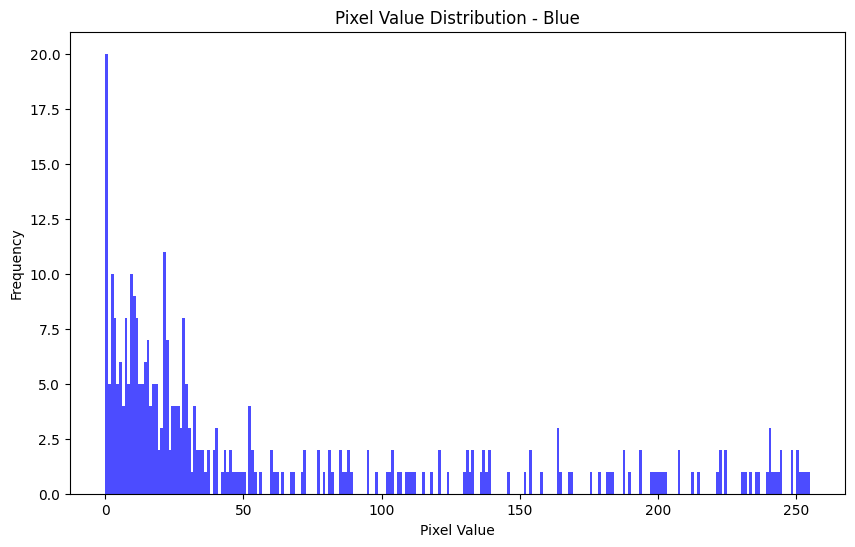

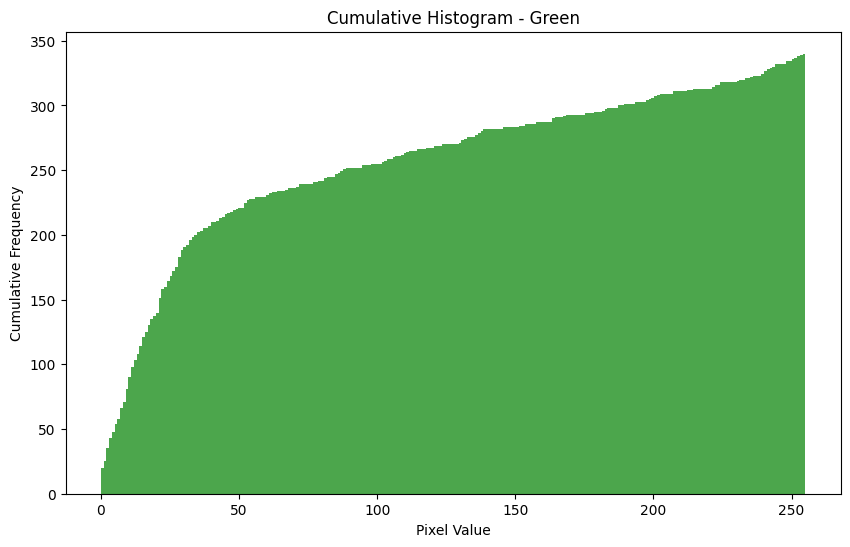

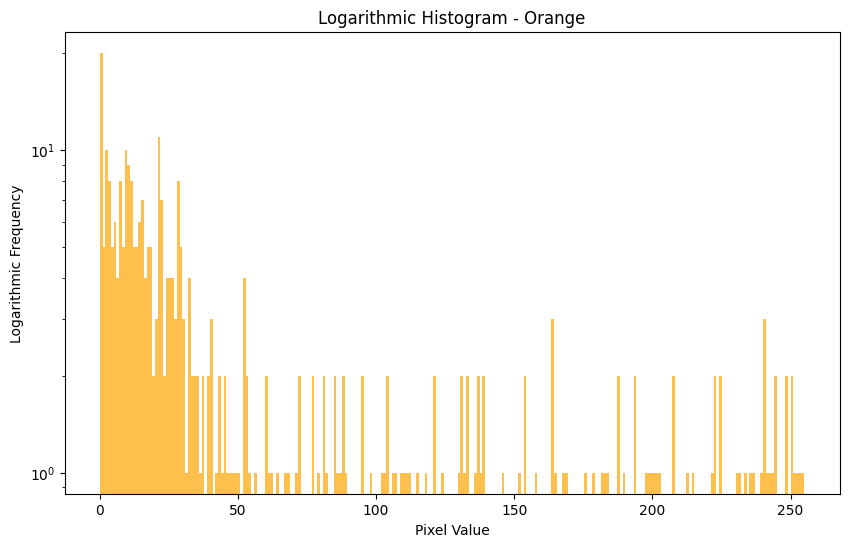

In [13]:
"""

Script to load an image, convert it to grayscale, and plot different types of histograms.

"""



import os

from PIL import Image

import numpy as np

import matplotlib.pyplot as plt



# Specify the path to the image file

image_file_path = r'/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg'



# Check if the image file exists at the given path

if not os.path.exists(image_file_path):

    print(f"Error: The file at {image_file_path} does not exist.")

else:

    try:

        # Load the image and convert it to grayscale

        grayscale_image = Image.open(image_file_path).convert('L')



        # Convert the grayscale image to a NumPy array

        image_array = np.array(grayscale_image)



        # Flatten the 2D image array into a 1D array

        flattened_image_array = image_array.flatten()



        # Plot the basic histogram of pixel values

        plt.figure(figsize=(10, 6))

        plt.hist(flattened_image_array, bins=256, range=(0, 255), color='blue', alpha=0.7)

        plt.title('Pixel Value Distribution - Blue')

        plt.xlabel('Pixel Value')

        plt.ylabel('Frequency')

        plt.show()



        # Plot the cumulative histogram

        plt.figure(figsize=(10, 6))

        plt.hist(flattened_image_array, bins=256, range=(0, 255), color='green', alpha=0.7, cumulative=True)

        plt.title('Cumulative Histogram - Green')

        plt.xlabel('Pixel Value')

        plt.ylabel('Cumulative Frequency')

        plt.show()



        # Plot the logarithmic histogram

        plt.figure(figsize=(10, 6))

        plt.hist(flattened_image_array, bins=256, range=(0, 255), color='orange', alpha=0.7, log=True)

        plt.title('Logarithmic Histogram - Orange')

        plt.xlabel('Pixel Value')

        plt.ylabel('Logarithmic Frequency')

        plt.show()



    except OSError as error:

        print(f"Error opening the image: {error}")


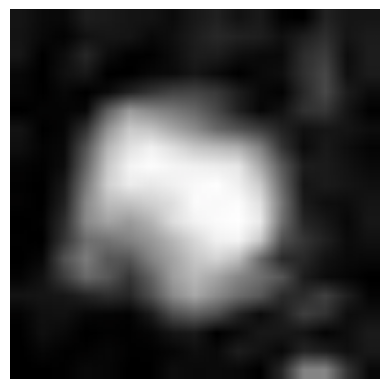

In [14]:
"""

Script to create a custom PyTorch dataset for loading a single image, apply transformations, and display it.

"""



import torch

from torchvision import transforms

from torch.utils.data import DataLoader, Dataset

from PIL import Image

import matplotlib.pyplot as plt



# Define the image transformation pipeline (resize, tensor conversion, normalization)

image_transforms = transforms.Compose([

    transforms.Resize((224, 224)),                               # Resize image to 224x224 pixels

    transforms.ToTensor(),                                       # Convert image to PyTorch tensor

    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize image

])



# Define a custom dataset class for loading a single image

class SingleImageDataset(Dataset):

    def __init__(self, image_file_path, transform=None):

        """

        Initialize the dataset with the image path and optional transformations.



        Args:

            image_file_path (str): Path to the image file.

            transform (callable, optional): Optional transform to apply to the image.

        """

        self.image_file_path = image_file_path

        self.transform = transform



    def __len__(self):

        """

        Return the number of samples in the dataset.

        """

        return 1  # The dataset contains only one image



    def __getitem__(self, idx):

        """

        Load and return an image from the dataset.



        Args:

            idx (int): Index of the image (not used, since we only have one image).

        """

        image = Image.open(self.image_file_path).convert("RGB")  # Open and convert image to RGB format

        if self.transform:

            image = self.transform(image)  # Apply the transformations if specified

        return image



# Path to the image file (update with the correct path)

image_file_path = r'/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg'

dataset = SingleImageDataset(image_file_path=image_file_path, transform=image_transforms)



# Create a DataLoader for the single-image dataset

data_loader = DataLoader(dataset, batch_size=1, shuffle=False)



# Display the transformed image

for image_tensor in data_loader:

    image_tensor = image_tensor.squeeze(0)  # Remove the batch dimension

    image_tensor = image_tensor.permute(1, 2, 0)  # Rearrange dimensions to HxWxC for display



    # Unnormalize the image for visualization

    image_tensor = image_tensor * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])

    image_tensor = image_tensor.clamp(0, 1)  # Clamp pixel values to range [0, 1]



    plt.imshow(image_tensor)

    plt.axis('off')  # Hide the axis for a clean display

    plt.show()

    break  # Exit loop after displaying the first image


##

Sobel edge detection output:
 [[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
 [  0  18  24  17  18  26  18  23  28   4  16  19  14  61  30  26   0]
 [  0  10  37   1  36  22  12  28  24  35  40  24  35  63  39  40   0]
 [  0   6  32  29  17  39  64  69  53  47  28   1  46  76  37  58   0]
 [  0   5  13  30 123 179 170 140 111  95  65  19  45  75  28  71   0]
 [  0   3  22 129 223 208 181 138 109 106  98  70  37  47  47  60   0]
 [  0  10  64 195 220 127 130 146 150 168 185 159  74  22  33  32   0]
 [  0   6 103 227 199  97  79 116 143 173 191 198 157  49   5  21   0]
 [  0   9 133 242 179  63   3  29  61  82 118 197 200  78   8  23   0]
 [  0  26 158 233 140  64  54  33  14  20  72 186 233 104  13  11   0]
 [  0  40 174 201  94  89  80  63  32   1  42 181 255 122  18   7   0]
 [  0  54 168 154  85  88 100  94  60  26  34 193 243 108  42   4   0]
 [  0  75 155  85  77  95 109 107  87  64 116 239 203  72  46  13   0]
 [  0  88 141  34  56  88 123 101  75  97 162 1

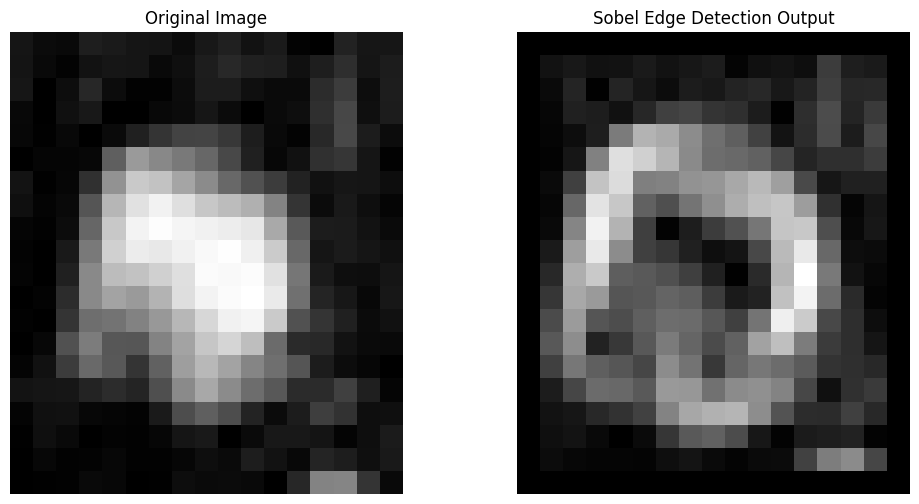

In [15]:
"""

Script to perform Sobel edge detection on an image and display/save the results.

"""



import numpy as np

from PIL import Image

import matplotlib.pyplot as plt  # For displaying images



# Define Sobel kernels for edge detection

sobel_kernel_x = np.array([[-1, 0, 1],

                           [-2, 0, 2],

                           [-1, 0, 1]])



sobel_kernel_y = np.array([[-1, -2, -1],

                           [ 0,  0,  0],

                           [ 1,  2,  1]])



# Function to apply convolution between an image and a kernel

def apply_convolution(input_image, kernel):

    """

    Apply a 2D convolution between an input image and a kernel.



    Args:

        input_image (numpy.ndarray): Grayscale image array.

        kernel (numpy.ndarray): Kernel to be applied.



    Returns:

        numpy.ndarray: Convoluted image.

    """

    # Get the dimensions of the image and the kernel

    height, width = input_image.shape

    kernel_height, kernel_width = kernel.shape



    # Initialize an output image with zeroes (same size as input)

    output_image = np.zeros((height, width))



    # Iterate through the image (excluding borders)

    for i in range(1, height - 1):

        for j in range(1, width - 1):

            # Extract the 3x3 region around the current pixel

            region = input_image[i-1:i+2, j-1:j+2]

            # Apply convolution (element-wise multiplication followed by summation)

            output_image[i, j] = np.sum(region * kernel)



    return output_image



# Function to compute the gradient magnitude from Sobel outputs

def compute_gradient_magnitude(sobel_x, sobel_y):

    """

    Calculate the gradient magnitude from Sobel X and Y outputs.



    Args:

        sobel_x (numpy.ndarray): Sobel output in the x-direction.

        sobel_y (numpy.ndarray): Sobel output in the y-direction.



    Returns:

        numpy.ndarray: Gradient magnitude image.

    """

    return np.sqrt(sobel_x**2 + sobel_y**2)



# Function to normalize an image for visualization

def normalize_image(image):

    """

    Normalize the image pixel values to the range [0, 255].



    Args:

        image (numpy.ndarray): Input image array.



    Returns:

        numpy.ndarray: Normalized image as an integer array.

    """

    image_min = np.min(image)

    image_max = np.max(image)

    normalized_img = (image - image_min) / (image_max - image_min) * 255

    return normalized_img.astype(np.uint8)



# Load the input image (convert to grayscale)

image_path = '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg'  # Replace with your image path

input_image = Image.open(image_path).convert('L')  # Convert image to grayscale mode



# Convert the image to a NumPy array

image_array = np.array(input_image)



# Apply Sobel operators to detect edges in both directions

sobel_x_result = apply_convolution(image_array, sobel_kernel_x)

sobel_y_result = apply_convolution(image_array, sobel_kernel_y)



# Calculate the gradient magnitude from the Sobel outputs

sobel_gradient_magnitude = compute_gradient_magnitude(sobel_x_result, sobel_y_result)



# Normalize the magnitude image for visualization

normalized_sobel_output = normalize_image(sobel_gradient_magnitude)

print("Sobel edge detection output:\n", normalized_sobel_output)



# Convert the processed image back to a PIL Image for saving

output_image = Image.fromarray(normalized_sobel_output)



# Save the output image

output_image.save('sobel_edge_detection_output.png')

print("Sobel edge detection output saved as 'sobel_edge_detection_output.png'")



# Display the original and processed images using matplotlib

plt.figure(figsize=(12, 6))



# Display the original image

plt.subplot(1, 2, 1)

plt.title("Original Image")

plt.imshow(image_array, cmap='gray')

plt.axis('off')  # Hide the axes



# Display the Sobel edge detection output

plt.subplot(1, 2, 2)

plt.title("Sobel Edge Detection Output")

plt.imshow(normalized_sobel_output, cmap='gray')

plt.axis('off')  # Hide the axes



plt.show()  # Display the figure with both images


Sobel edge detection result saved as 'sobel_edge_detection_result.png'


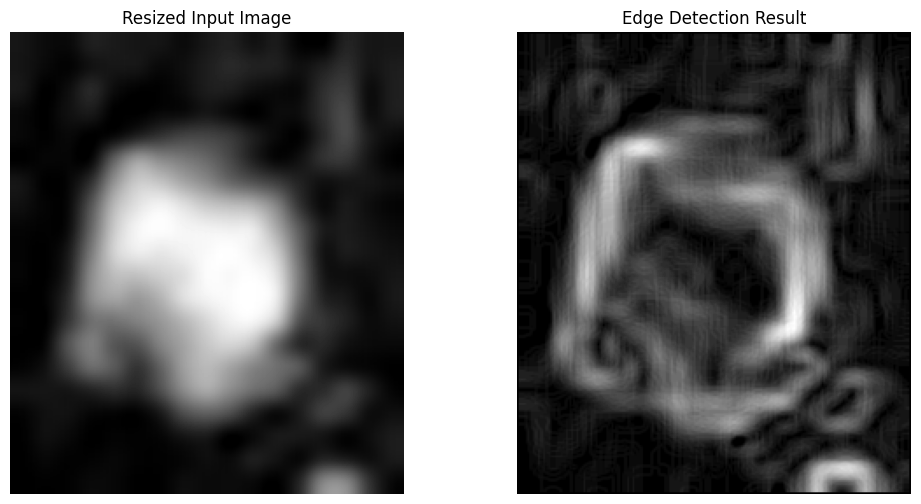

In [16]:
# Sobel Edge Detection on an Image

# This code applies Sobel filters to detect edges in a given image and displays the original and processed outputs.



import numpy as np

from PIL import Image

import matplotlib.pyplot as plt



# Define Sobel kernels for edge detection

sobel_kernel_x = np.array([[-1, 0, 1],

                           [-2, 0, 2],

                           [-1, 0, 1]])



sobel_kernel_y = np.array([[-1, -2, -1],

                           [ 0,  0,  0],

                           [ 1,  2,  1]])



# Function to apply convolution between the image and a kernel

def apply_convolution(image_array, kernel):

    img_height, img_width = image_array.shape  # Get dimensions of the image

    output_image_array = np.zeros((img_height, img_width))  # Initialize output image array



    # Iterate through each pixel (excluding the border pixels)

    for row in range(1, img_height - 1):

        for col in range(1, img_width - 1):

            # Extract a 3x3 region around the current pixel

            region = image_array[row - 1:row + 2, col - 1:col + 2]

            output_image_array[row, col] = np.sum(region * kernel)  # Apply the kernel and store the result



    return output_image_array



# Function to calculate the gradient magnitude from Sobel filter outputs

def compute_gradient_magnitude(output_x, output_y):

    # Calculate the Euclidean magnitude of the gradient

    return np.sqrt(output_x**2 + output_y**2)



# Function to normalize an image array for better visualization

def normalize_image_array(image_array):

    min_value = np.min(image_array)  # Find minimum pixel value

    max_value = np.max(image_array)  # Find maximum pixel value

    normalized_array = (image_array - min_value) / (max_value - min_value) * 255  # Normalize to range [0, 255]

    return normalized_array.astype(np.uint8)  # Convert to 8-bit unsigned integer



# Load the input image and convert it to grayscale

input_image_path = '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg'  # Replace with your image path

grayscale_image = Image.open(input_image_path).convert('L')  # Convert the image to grayscale



# Resize the image while maintaining the aspect ratio

target_width = 225  # Desired width for resizing

aspect_ratio = grayscale_image.height / grayscale_image.width

target_height = int(target_width * aspect_ratio)

resized_image = grayscale_image.resize((target_width, target_height))



# Convert the resized image to a NumPy array for processing

image_array = np.array(resized_image)



# Apply Sobel filters to detect edges in the image

sobel_x_result = apply_convolution(image_array, sobel_kernel_x)

sobel_y_result = apply_convolution(image_array, sobel_kernel_y)



# Calculate the gradient magnitude from the Sobel outputs

gradient_magnitude = compute_gradient_magnitude(sobel_x_result, sobel_y_result)



# Normalize the gradient magnitude for better visualization

normalized_gradient = normalize_image_array(gradient_magnitude)



# Convert the processed image back to a PIL image format for saving

processed_image = Image.fromarray(normalized_gradient)



# Save the processed image to disk

processed_image.save('sobel_edge_detection_result.png')

print("Sobel edge detection result saved as 'sobel_edge_detection_result.png'")



# Display the original resized image and the processed edge-detected image

plt.figure(figsize=(12, 6))



# Display the resized input image

plt.subplot(1, 2, 1)

plt.title("Resized Input Image")

plt.imshow(image_array, cmap='gray')

plt.axis('off')



# Display the output image after Sobel edge detection

plt.subplot(1, 2, 2)

plt.title("Edge Detection Result")

plt.imshow(normalized_gradient, cmap='gray')

plt.axis('off')



plt.show()  # Show the two images side by side


Combined Sobel edge detection output saved as 'sobel_edge_detection_combined_output.png'


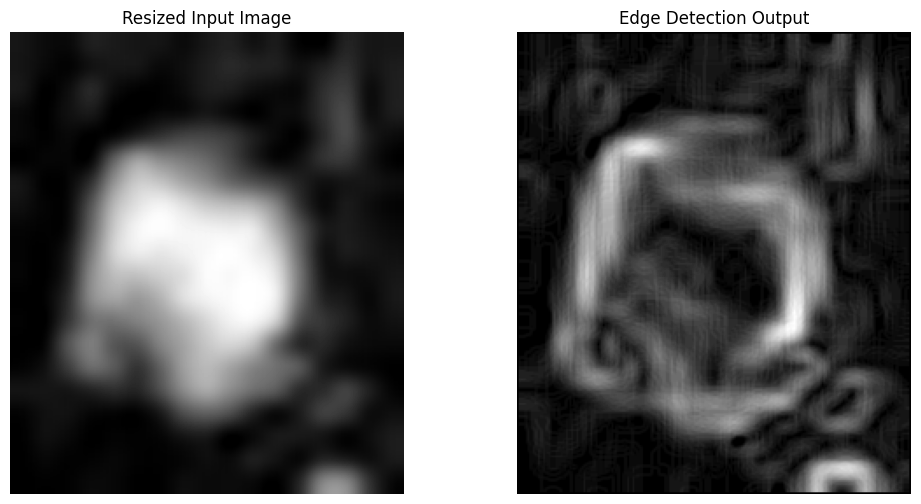

In [17]:
# Combined Sobel Edge Detection on an Image

# This code applies the Sobel operator to detect edges and displays the original and processed outputs.



import numpy as np

from PIL import Image

import matplotlib.pyplot as plt



# Define Sobel kernels for edge detection in x and y directions

sobel_kernel_x = np.array([[-1, 0, 1],

                           [-2, 0, 2],

                           [-1, 0, 1]])



sobel_kernel_y = np.array([[-1, -2, -1],

                           [ 0,  0,  0],

                           [ 1,  2,  1]])



# Function to apply combined Sobel operator for edge detection

def apply_sobel_combined(input_image):

    img_height, img_width = input_image.shape  # Get the dimensions of the image

    edge_detected_image = np.zeros((img_height, img_width))  # Initialize the output image



    # Iterate through each pixel (avoiding the borders)

    for row in range(1, img_height - 1):

        for col in range(1, img_width - 1):

            region = input_image[row - 1:row + 2, col - 1:col + 2]  # Extract 3x3 region around the pixel



            # Apply Sobel kernels to get gradients in x and y directions

            gradient_x = np.sum(region * sobel_kernel_x)

            gradient_y = np.sum(region * sobel_kernel_y)



            # Compute the gradient magnitude

            edge_detected_image[row, col] = np.sqrt(gradient_x**2 + gradient_y**2)



    return edge_detected_image



# Function to normalize an image array for better visualization

def normalize_image(image_array):

    min_value = np.min(image_array)  # Find the minimum value in the image

    max_value = np.max(image_array)  # Find the maximum value in the image

    normalized_image_array = (image_array - min_value) / (max_value - min_value) * 255  # Normalize to [0, 255]

    return normalized_image_array.astype(np.uint8)  # Convert to 8-bit unsigned integer



# Load the input image and convert it to grayscale

input_image_path = '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg'  # Update this with your image path

grayscale_image = Image.open(input_image_path).convert('L')  # Convert the image to grayscale



# Resize the image while maintaining the aspect ratio

target_width = 225  # Set desired width for resizing

aspect_ratio = grayscale_image.height / grayscale_image.width

target_height = int(target_width * aspect_ratio)

resized_image = grayscale_image.resize((target_width, target_height))



# Convert the resized image to a NumPy array for processing

input_image_array = np.array(resized_image)



# Apply the combined Sobel operator to detect edges

sobel_combined_result = apply_sobel_combined(input_image_array)



# Normalize the result for visualization

normalized_edge_image = normalize_image(sobel_combined_result)



# Convert the processed image back to a PIL image for saving

output_image = Image.fromarray(normalized_edge_image)



# Save the output image to disk

output_image.save('sobel_edge_detection_combined_output.png')

print("Combined Sobel edge detection output saved as 'sobel_edge_detection_combined_output.png'")



# Display the original resized image and the processed edge-detected image

plt.figure(figsize=(12, 6))



# Display the resized input image

plt.subplot(1, 2, 1)

plt.title("Resized Input Image")

plt.imshow(input_image_array, cmap='gray')

plt.axis('off')  # Hide axes



# Display the edge-detected output image

plt.subplot(1, 2, 2)

plt.title("Edge Detection Output")

plt.imshow(normalized_edge_image, cmap='gray')

plt.axis('off')  # Hide axes



plt.show()  # Display the images side by side


Edge detection (Sobel) and LBP images have been saved as 'sobel_edge_detection_output.png' and 'lbp_output_image.png'.


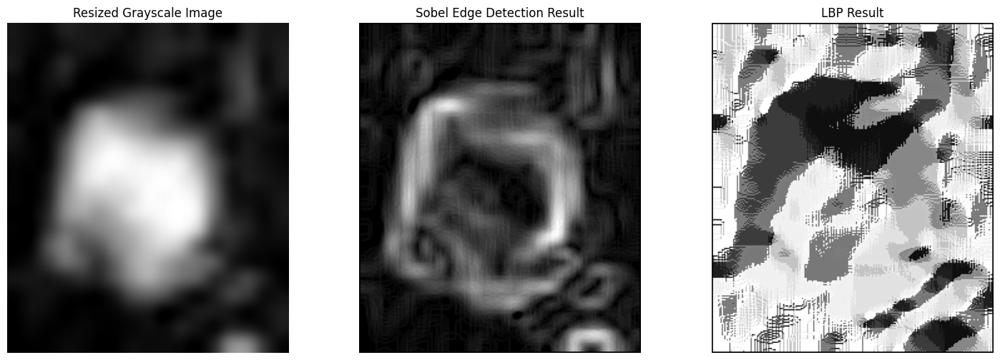

In [18]:
# This script applies edge detection using the Sobel operator and calculates the Local Binary Pattern (LBP) on an image.

# It loads an image, applies the Sobel filter to detect edges, and computes the LBP for texture analysis.



import numpy as np

from PIL import Image

import matplotlib.pyplot as plt



# Define Sobel kernels for edge detection

sobel_kernel_x = np.array([[-1, 0, 1],

                           [-2, 0, 2],

                           [-1, 0, 1]])



sobel_kernel_y = np.array([[-1, -2, -1],

                           [ 0,  0,  0],

                           [ 1,  2,  1]])



# Function to apply convolution between an image and a kernel

def apply_convolution(image_array, kernel):

    image_height, image_width = image_array.shape

    convolved_image = np.zeros((image_height, image_width))



    # Perform the convolution operation

    for row in range(1, image_height - 1):

        for col in range(1, image_width - 1):

            local_region = image_array[row - 1:row + 2, col - 1:col + 2]  # Extract 3x3 region around the pixel

            convolved_image[row, col] = np.sum(local_region * kernel)  # Apply kernel to region



    return convolved_image



# Function to compute gradient magnitude from Sobel filter outputs

def calculate_gradient_magnitude(sobel_x_result, sobel_y_result):

    return np.sqrt(sobel_x_result**2 + sobel_y_result**2)



# Function to normalize an image to 0-255 range for visualization

def normalize_image_for_display(image_array):

    min_value = np.min(image_array)

    max_value = np.max(image_array)

    normalized_image = (image_array - min_value) / (max_value - min_value) * 255

    return normalized_image.astype(np.uint8)



# Function to compute Local Binary Pattern (LBP)

def generate_lbp(image_array):

    image_height, image_width = image_array.shape

    lbp_result = np.zeros((image_height, image_width), dtype=np.uint8)



    # Calculate LBP for each pixel (excluding the border)

    for row in range(1, image_height - 1):

        for col in range(1, image_width - 1):

            center_pixel = image_array[row, col]

            binary_code = ''



            # Extract and compare the 8 neighboring pixels to the center pixel

            binary_code += '1' if image_array[row - 1, col - 1] >= center_pixel else '0'

            binary_code += '1' if image_array[row - 1, col] >= center_pixel else '0'

            binary_code += '1' if image_array[row - 1, col + 1] >= center_pixel else '0'

            binary_code += '1' if image_array[row, col + 1] >= center_pixel else '0'

            binary_code += '1' if image_array[row + 1, col + 1] >= center_pixel else '0'

            binary_code += '1' if image_array[row + 1, col] >= center_pixel else '0'

            binary_code += '1' if image_array[row + 1, col - 1] >= center_pixel else '0'

            binary_code += '1' if image_array[row, col - 1] >= center_pixel else '0'



            # Convert binary string to decimal and store in the LBP image

            lbp_result[row, col] = int(binary_code, 2)



    return lbp_result



# Load and preprocess the image

input_image_path = '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg'  # Replace with the path to your image

image = Image.open(input_image_path).convert('L')  # Convert the image to grayscale



# Resize the image to a width of 225 pixels while maintaining aspect ratio

resize_width = 225

resize_aspect_ratio = image.height / image.width

resize_height = int(resize_width * resize_aspect_ratio)

resized_image = image.resize((resize_width, resize_height))



# Convert the resized image to a NumPy array for processing

image_array = np.array(resized_image)



# Apply the Sobel operators to detect edges

sobel_x_output = apply_convolution(image_array, sobel_kernel_x)

sobel_y_output = apply_convolution(image_array, sobel_kernel_y)



# Calculate the gradient magnitude for edge detection

sobel_magnitude = calculate_gradient_magnitude(sobel_x_output, sobel_y_output)



# Normalize the Sobel output for better visualization

normalized_sobel_image = normalize_image_for_display(sobel_magnitude)



# Generate the LBP for texture analysis

lbp_result = generate_lbp(image_array)



# Normalize the LBP output for display

normalized_lbp_image = normalize_image_for_display(lbp_result)



# Convert arrays to PIL Images for saving

sobel_image = Image.fromarray(normalized_sobel_image)

lbp_image = Image.fromarray(normalized_lbp_image)



# Save the output images

sobel_image.save('sobel_edge_detection_output.png')

lbp_image.save('lbp_output_image.png')

print("Edge detection (Sobel) and LBP images have been saved as 'sobel_edge_detection_output.png' and 'lbp_output_image.png'.")



# Display the original resized image, Sobel output, and LBP output using matplotlib

plt.figure(figsize=(18, 6))



# Display the original image

plt.subplot(1, 3, 1)

plt.title("Resized Grayscale Image")

plt.imshow(image_array, cmap='gray')

plt.axis('off')



# Display the Sobel edge detection result

plt.subplot(1, 3, 2)

plt.title("Sobel Edge Detection Result")

plt.imshow(normalized_sobel_image, cmap='gray')

plt.axis('off')



# Display the LBP result

plt.subplot(1, 3, 3)

plt.title("LBP Result")

plt.imshow(normalized_lbp_image, cmap='gray')

plt.axis('off')



plt.show()  # Render the plots


Sobel and LBP output images saved as 'sobel_edge_detection_output.png' and 'lbp_output_image.png'.


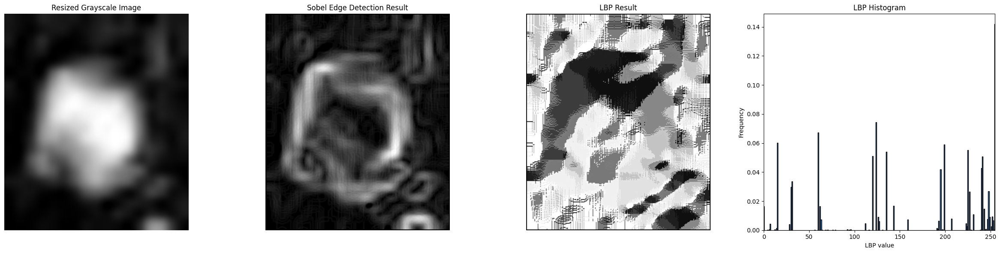

In [19]:
# This script performs edge detection using the Sobel operator and computes the Local Binary Pattern (LBP)

# for texture analysis on a grayscale image. It also calculates the LBP histogram for feature extraction.



import numpy as np

from PIL import Image

import matplotlib.pyplot as plt



# Define Sobel kernels for edge detection

sobel_kernel_x = np.array([[-1, 0, 1],

                           [-2, 0, 2],

                           [-1, 0, 1]])



sobel_kernel_y = np.array([[-1, -2, -1],

                           [ 0,  0,  0],

                           [ 1,  2,  1]])



# Function to apply convolution between an image and a kernel

def apply_convolution(input_image, kernel):

    image_height, image_width = input_image.shape

    convolved_image = np.zeros((image_height, image_width))



    # Perform convolution over the image excluding the borders

    for row in range(1, image_height - 1):

        for col in range(1, image_width - 1):

            local_region = input_image[row - 1:row + 2, col - 1:col + 2]  # 3x3 region around the current pixel

            convolved_image[row, col] = np.sum(local_region * kernel)  # Apply kernel to the local region



    return convolved_image



# Function to compute gradient magnitude from Sobel filter outputs

def compute_gradient_magnitude(sobel_x_result, sobel_y_result):

    return np.sqrt(sobel_x_result**2 + sobel_y_result**2)



# Function to normalize an image for visualization (scales to 0-255)

def normalize_image_for_display(image_array):

    min_value = np.min(image_array)

    max_value = np.max(image_array)

    normalized_image = (image_array - min_value) / (max_value - min_value) * 255

    return normalized_image.astype(np.uint8)



# Function to compute Local Binary Pattern (LBP)

def generate_lbp(input_image):

    image_height, image_width = input_image.shape

    lbp_result = np.zeros((image_height, image_width), dtype=np.uint8)



    # Calculate LBP for each pixel, excluding the image borders

    for row in range(1, image_height - 1):

        for col in range(1, image_width - 1):

            center_pixel = input_image[row, col]

            binary_code = ''



            # Compare the 8 neighbors with the center pixel (clockwise starting from top-left)

            binary_code += '1' if input_image[row - 1, col - 1] >= center_pixel else '0'

            binary_code += '1' if input_image[row - 1, col] >= center_pixel else '0'

            binary_code += '1' if input_image[row - 1, col + 1] >= center_pixel else '0'

            binary_code += '1' if input_image[row, col + 1] >= center_pixel else '0'

            binary_code += '1' if input_image[row + 1, col + 1] >= center_pixel else '0'

            binary_code += '1' if input_image[row + 1, col] >= center_pixel else '0'

            binary_code += '1' if input_image[row + 1, col - 1] >= center_pixel else '0'

            binary_code += '1' if input_image[row, col - 1] >= center_pixel else '0'



            # Convert binary string to decimal and store in the LBP image

            lbp_result[row, col] = int(binary_code, 2)



    return lbp_result



# Function to compute the histogram of LBP values

def compute_lbp_histogram(lbp_image):

    # LBP values range from 0 to 255 (8-bit pattern)

    histogram, _ = np.histogram(lbp_image.ravel(), bins=np.arange(257), density=True)

    return histogram



# Load and preprocess the image

input_image_path = '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg'  # Update with your image path

input_image = Image.open(input_image_path).convert('L')  # Convert to grayscale



# Resize the image to a fixed width while maintaining the aspect ratio

resize_width = 225

resize_aspect_ratio = input_image.height / input_image.width

resize_height = int(resize_width * resize_aspect_ratio)

resized_image = input_image.resize((resize_width, resize_height))



# Convert the resized image to a NumPy array for processing

image_array = np.array(resized_image)



# Apply Sobel operators to detect edges in both x and y directions

sobel_x_output = apply_convolution(image_array, sobel_kernel_x)

sobel_y_output = apply_convolution(image_array, sobel_kernel_y)



# Compute the gradient magnitude (Sobel magnitude)

sobel_magnitude = compute_gradient_magnitude(sobel_x_output, sobel_y_output)



# Normalize the Sobel output for better visualization

normalized_sobel_image = normalize_image_for_display(sobel_magnitude)



# Generate LBP for texture analysis

lbp_result_image = generate_lbp(image_array)



# Normalize the LBP image for visualization

normalized_lbp_image = normalize_image_for_display(lbp_result_image)



# Compute the histogram of LBP values for feature analysis

lbp_histogram = compute_lbp_histogram(lbp_result_image)



# Convert the processed images to PIL Images for saving

sobel_image_output = Image.fromarray(normalized_sobel_image)

lbp_image_output = Image.fromarray(normalized_lbp_image)



# Save the Sobel and LBP output images

sobel_image_output.save('sobel_edge_detection_output.png')

lbp_image_output.save('lbp_output_image.png')

print("Sobel and LBP output images saved as 'sobel_edge_detection_output.png' and 'lbp_output_image.png'.")



# Display the original resized image, Sobel output, LBP output, and LBP histogram using matplotlib

plt.figure(figsize=(24, 6))



# Display the original resized image

plt.subplot(1, 4, 1)

plt.title("Resized Grayscale Image")

plt.imshow(image_array, cmap='gray')

plt.axis('off')



# Display the Sobel edge detection result

plt.subplot(1, 4, 2)

plt.title("Sobel Edge Detection Result")

plt.imshow(normalized_sobel_image, cmap='gray')

plt.axis('off')



# Display the LBP result

plt.subplot(1, 4, 3)

plt.title("LBP Result")

plt.imshow(normalized_lbp_image, cmap='gray')

plt.axis('off')



# Display the LBP histogram

plt.subplot(1, 4, 4)

plt.title("LBP Histogram")

plt.bar(np.arange(256), lbp_histogram, width=1, edgecolor='black')

plt.xlim([0, 255])

plt.xlabel('LBP value')

plt.ylabel('Frequency')



plt.tight_layout()

plt.show()  # Render the plots


In [ ]:
#

Original Image - Mean: 63.16776094276094, Variance: 5629.832546501775, Median: 25.0
Sobel Magnitude - Mean: 19.392233683861036, Variance: 312.9461212353739, Median: 13.416407864998739
LBP Image - Mean: 161.48045454545453, Variance: 7227.481368816959, Median: 195.0
Sobel and LBP outputs saved as 'sobel_edge_detection_output.png' and 'lbp_output.png'


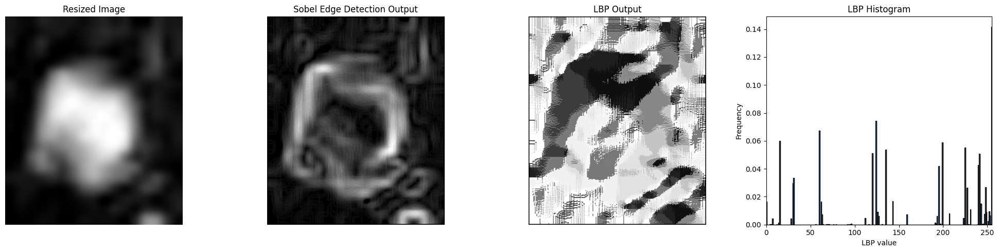

In [20]:
# Image Processing Pipeline for Edge Detection and Local Binary Pattern (LBP) Analysis

# This code applies Sobel edge detection and computes the LBP of an input image.

# It also calculates and prints statistics (mean, variance, median) for the images.



import numpy as np

from PIL import Image

import matplotlib.pyplot as plt



# Define Sobel kernels for edge detection

sobel_kernel_x = np.array([[-1, 0, 1],

                           [-2, 0, 2],

                           [-1, 0, 1]])



sobel_kernel_y = np.array([[-1, -2, -1],

                           [ 0,  0,  0],

                           [ 1,  2,  1]])



# Function to apply convolution between an image and a kernel

def perform_convolution(input_image, convolution_kernel):

    img_height, img_width = input_image.shape

    convolved_image = np.zeros((img_height, img_width))



    # Apply the convolution operation

    for row in range(1, img_height - 1):

        for col in range(1, img_width - 1):

            region = input_image[row-1:row+2, col-1:col+2]  # 3x3 region surrounding the pixel

            convolved_image[row, col] = np.sum(region * convolution_kernel)



    return convolved_image



# Function to calculate the gradient magnitude from Sobel outputs

def calculate_gradient_magnitude(sobel_x_result, sobel_y_result):

    return np.sqrt(sobel_x_result**2 + sobel_y_result**2)



# Function to normalize an image for visualization

def normalize_for_display(image_array):

    min_value = np.min(image_array)

    max_value = np.max(image_array)

    normalized_array = (image_array - min_value) / (max_value - min_value) * 255

    return normalized_array.astype(np.uint8)



# Function to compute Local Binary Pattern (LBP)

def calculate_lbp(input_image):

    img_height, img_width = input_image.shape

    lbp_result = np.zeros((img_height, img_width), dtype=np.uint8)



    # Process each pixel (excluding the borders)

    for row in range(1, img_height - 1):

        for col in range(1, img_width - 1):

            central_pixel = input_image[row, col]

            binary_pattern = ''



            # Compare neighboring pixels to the central pixel in a clockwise direction

            binary_pattern += '1' if input_image[row-1, col-1] >= central_pixel else '0'

            binary_pattern += '1' if input_image[row-1, col] >= central_pixel else '0'

            binary_pattern += '1' if input_image[row-1, col+1] >= central_pixel else '0'

            binary_pattern += '1' if input_image[row, col+1] >= central_pixel else '0'

            binary_pattern += '1' if input_image[row+1, col+1] >= central_pixel else '0'

            binary_pattern += '1' if input_image[row+1, col] >= central_pixel else '0'

            binary_pattern += '1' if input_image[row+1, col-1] >= central_pixel else '0'

            binary_pattern += '1' if input_image[row, col-1] >= central_pixel else '0'



            # Convert binary pattern to decimal for LBP assignment

            lbp_result[row, col] = int(binary_pattern, 2)



    return lbp_result



# Function to compute a histogram for LBP values

def generate_lbp_histogram(lbp_image):

    histogram, _ = np.histogram(lbp_image.ravel(), bins=np.arange(257), density=True)

    return histogram



# Function to calculate basic statistics of an image

def compute_image_statistics(image_array):

    image_mean = np.mean(image_array)

    image_variance = np.var(image_array)

    image_median = np.median(image_array)

    return image_mean, image_variance, image_median



# Load the input image and convert to grayscale

image_path = '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg'  # Specify your image path here

input_image = Image.open(image_path).convert('L')  # Convert to grayscale



# Resize the image while maintaining the aspect ratio

desired_width = 225

image_aspect_ratio = input_image.height / input_image.width

new_image_height = int(desired_width * image_aspect_ratio)

resized_image = input_image.resize((desired_width, new_image_height))



# Convert the image to a NumPy array for processing

image_array = np.array(resized_image)



# Calculate statistics for the original image

original_mean, original_variance, original_median = compute_image_statistics(image_array)

print(f"Original Image - Mean: {original_mean}, Variance: {original_variance}, Median: {original_median}")



# Apply Sobel filters to detect edges

sobel_x_result = perform_convolution(image_array, sobel_kernel_x)

sobel_y_result = perform_convolution(image_array, sobel_kernel_y)



# Compute gradient magnitude (Sobel magnitude)

gradient_magnitude = calculate_gradient_magnitude(sobel_x_result, sobel_y_result)



# Normalize the Sobel magnitude for visualization

normalized_sobel_image = normalize_for_display(gradient_magnitude)



# Calculate statistics for the Sobel magnitude image

sobel_mean, sobel_variance, sobel_median = compute_image_statistics(gradient_magnitude)

print(f"Sobel Magnitude - Mean: {sobel_mean}, Variance: {sobel_variance}, Median: {sobel_median}")



# Calculate LBP for the image

lbp_result = calculate_lbp(image_array)



# Normalize the LBP result for visualization

normalized_lbp_image = normalize_for_display(lbp_result)



# Calculate statistics for the LBP image

lbp_mean, lbp_variance, lbp_median = compute_image_statistics(lbp_result)

print(f"LBP Image - Mean: {lbp_mean}, Variance: {lbp_variance}, Median: {lbp_median}")



# Generate LBP histogram

lbp_histogram_data = generate_lbp_histogram(lbp_result)



# Convert processed arrays to PIL images

sobel_image = Image.fromarray(normalized_sobel_image)

lbp_image = Image.fromarray(normalized_lbp_image)



# Save processed images

sobel_image.save('sobel_edge_detection_output.png')

lbp_image.save('lbp_output.png')

print("Sobel and LBP outputs saved as 'sobel_edge_detection_output.png' and 'lbp_output.png'")



# Display images and histogram using matplotlib

plt.figure(figsize=(20, 5))



# Display the resized image

plt.subplot(1, 4, 1)

plt.title("Resized Image")

plt.imshow(image_array, cmap='gray')

plt.axis('off')



# Display Sobel edge detection output

plt.subplot(1, 4, 2)

plt.title("Sobel Edge Detection Output")

plt.imshow(normalized_sobel_image, cmap='gray')

plt.axis('off')



# Display LBP output

plt.subplot(1, 4, 3)

plt.title("LBP Output")

plt.imshow(normalized_lbp_image, cmap='gray')

plt.axis('off')



# Display LBP histogram

plt.subplot(1, 4, 4)

plt.title("LBP Histogram")

plt.bar(np.arange(256), lbp_histogram_data, width=1, edgecolor='black')

plt.xlim([0, 255])

plt.xlabel('LBP value')

plt.ylabel('Frequency')



plt.tight_layout()

plt.show()


LBP Mean, Variance, and Median images saved as 'lbp_mean_based.png', 'lbp_variance_based.png', and 'lbp_median_based.png'


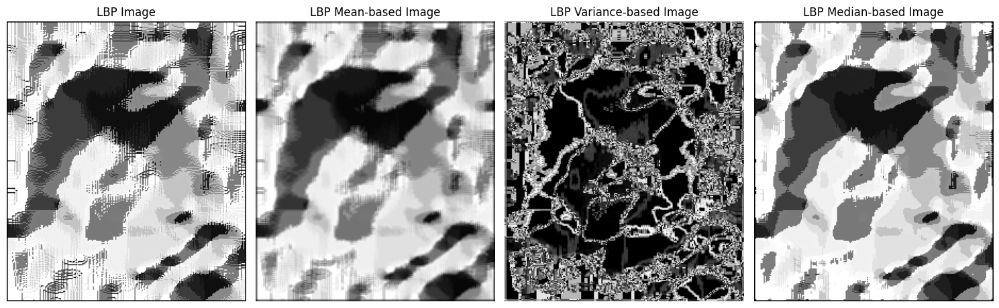

In [21]:
# Image Processing for LBP with Local Mean, Variance, and Median Transformations

# This code computes the Local Binary Pattern (LBP) of an image and applies local mean,

# variance, and median transformations to enhance image features.



import numpy as np

from PIL import Image

import matplotlib.pyplot as plt

from scipy.ndimage import generic_filter



# Define Sobel kernels for edge detection (not used in this version but kept for completeness)

sobel_x = np.array([[-1, 0, 1],

                    [-2, 0, 2],

                    [-1, 0, 1]])



sobel_y = np.array([[-1, -2, -1],

                    [ 0,  0,  0],

                    [ 1,  2,  1]])



# Function to apply convolution between an image and a kernel

def apply_convolution(image, kernel):

    """Applies a convolution operation on an image using the provided kernel."""

    height, width = image.shape

    output_image = np.zeros((height, width))



    for i in range(1, height - 1):

        for j in range(1, width - 1):

            region = image[i-1:i+2, j-1:j+2]  # 3x3 region around the current pixel

            output_image[i, j] = np.sum(region * kernel)



    return output_image



# Function to compute gradient magnitude from Sobel outputs

def compute_gradient_magnitude(sobel_x_output, sobel_y_output):

    """Computes the gradient magnitude from Sobel filtered outputs."""

    return np.sqrt(sobel_x_output**2 + sobel_y_output**2)



# Function to normalize the image for display

def normalize_image(image):

    """Normalizes an image array to the range 0-255 for display."""

    image_min = np.min(image)

    image_max = np.max(image)

    normalized_image = (image - image_min) / (image_max - image_min) * 255

    return normalized_image.astype(np.uint8)



# Function to compute Local Binary Pattern (LBP)

def compute_lbp(image):

    """Computes the Local Binary Pattern (LBP) for the given image."""

    height, width = image.shape

    lbp_image = np.zeros((height, width), dtype=np.uint8)



    for i in range(1, height - 1):

        for j in range(1, width - 1):

            center_pixel = image[i, j]

            binary_string = ''



            # Create a binary string based on comparisons to the center pixel

            binary_string += '1' if image[i-1, j-1] >= center_pixel else '0'

            binary_string += '1' if image[i-1, j] >= center_pixel else '0'

            binary_string += '1' if image[i-1, j+1] >= center_pixel else '0'

            binary_string += '1' if image[i, j+1] >= center_pixel else '0'

            binary_string += '1' if image[i+1, j+1] >= center_pixel else '0'

            binary_string += '1' if image[i+1, j] >= center_pixel else '0'

            binary_string += '1' if image[i+1, j-1] >= center_pixel else '0'

            binary_string += '1' if image[i, j-1] >= center_pixel else '0'



            lbp_image[i, j] = int(binary_string, 2)  # Convert binary string to decimal and store



    return lbp_image



# Function to compute the local mean with a given window size

def local_mean(image, size=3):

    """Calculates the local mean over a window of the given size."""

    return generic_filter(image, np.mean, size=size)



# Function to compute the local variance with a given window size

def local_variance(image, size=3):

    """Calculates the local variance over a window of the given size."""

    return generic_filter(image, np.var, size=size)



# Function to compute the local median with a given window size

def local_median(image, size=3):

    """Calculates the local median over a window of the given size."""

    return generic_filter(image, np.median, size=size)



# Load and resize the image

input_image_path = '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg'  # Path to the input image

input_image = Image.open(input_image_path).convert('L')  # Convert to grayscale

new_width = 225  # Desired width for resizing

aspect_ratio = input_image.height / input_image.width  # Maintain the aspect ratio

new_height = int(new_width * aspect_ratio)

resized_image = input_image.resize((new_width, new_height))

image_array = np.array(resized_image)



# Compute the LBP image

lbp_image = compute_lbp(image_array)



# Apply mean, variance, and median transformations to the LBP image

lbp_mean_based = local_mean(lbp_image, size=3)

lbp_variance_based = local_variance(lbp_image, size=3)

lbp_median_based = local_median(lbp_image, size=3)



# Normalize the transformed images for display

lbp_mean_based = normalize_image(lbp_mean_based)

lbp_variance_based = normalize_image(lbp_variance_based)

lbp_median_based = normalize_image(lbp_median_based)



# Convert to PIL images for saving

lbp_mean_image = Image.fromarray(lbp_mean_based)

lbp_variance_image = Image.fromarray(lbp_variance_based)

lbp_median_image = Image.fromarray(lbp_median_based)



# Save the images to disk

lbp_mean_image.save('lbp_mean_based.png')

lbp_variance_image.save('lbp_variance_based.png')

lbp_median_image.save('lbp_median_based.png')

print("LBP Mean, Variance, and Median images saved as 'lbp_mean_based.png', 'lbp_variance_based.png', and 'lbp_median_based.png'")



# Display the images using matplotlib

plt.figure(figsize=(15, 5))



# Display the original LBP image

plt.subplot(1, 4, 1)

plt.title("LBP Image")

plt.imshow(lbp_image, cmap='gray')

plt.axis('off')



# Display the LBP mean-based image

plt.subplot(1, 4, 2)

plt.title("LBP Mean-based Image")

plt.imshow(lbp_mean_based, cmap='gray')

plt.axis('off')



# Display the LBP variance-based image

plt.subplot(1, 4, 3)

plt.title("LBP Variance-based Image")

plt.imshow(lbp_variance_based, cmap='gray')

plt.axis('off')



# Display the LBP median-based image

plt.subplot(1, 4, 4)

plt.title("LBP Median-based Image")

plt.imshow(lbp_median_based, cmap='gray')

plt.axis('off')



plt.tight_layout()

plt.show()


Images for file 1 have been saved.


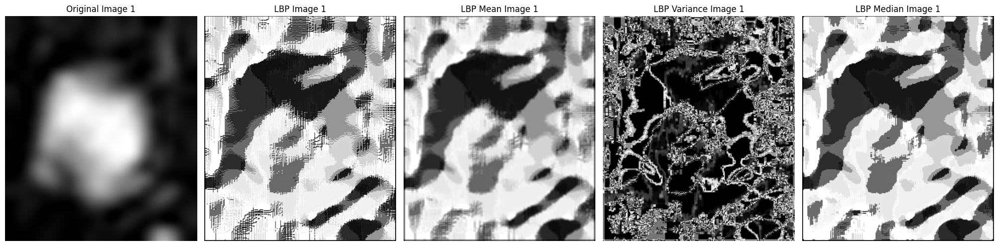

Images for file 2 have been saved.


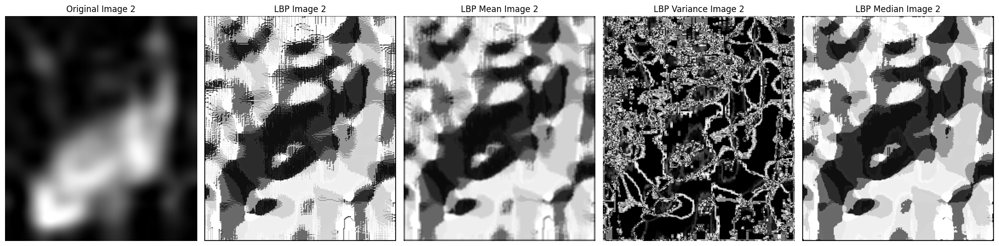

Images for file 3 have been saved.


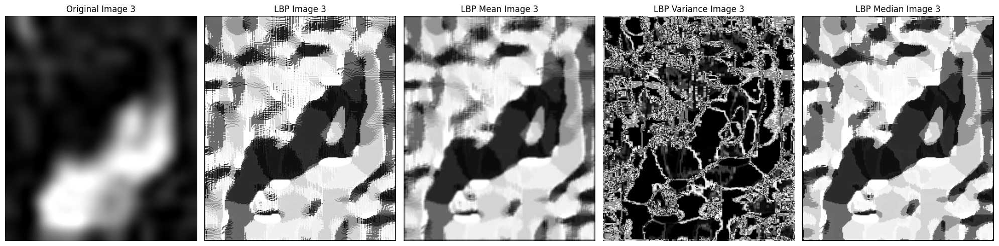

Images for file 4 have been saved.


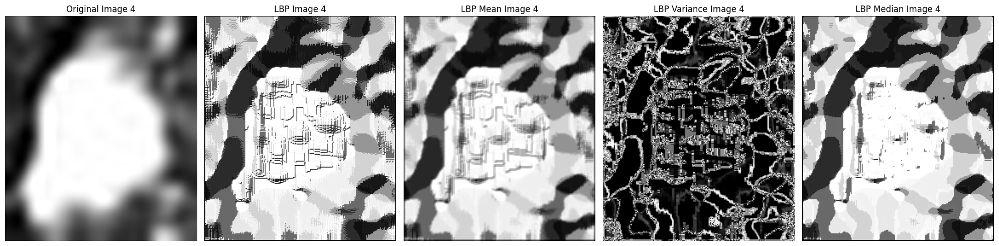

Images for file 5 have been saved.


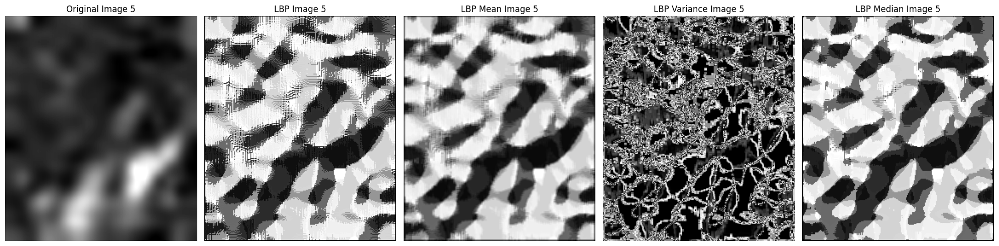

In [22]:
import numpy as np

from PIL import Image

import matplotlib.pyplot as plt

from scipy.ndimage import generic_filter

import os



# Function to normalize the image for display

def normalize_image(input_image):

    """Normalizes an image array to a range of 0-255 for better display."""

    min_value = np.min(input_image)

    max_value = np.max(input_image)

    normalized_result = ((input_image - min_value) / (max_value - min_value) * 255).astype(np.uint8)

    return normalized_result



# Function to compute Local Binary Pattern (LBP)

def calculate_lbp(image_array, radius=1, num_neighbors=8):

    """Calculates the Local Binary Pattern (LBP) for an input image array."""

    img_height, img_width = image_array.shape

    lbp_result = np.zeros((img_height, img_width), dtype=np.uint8)



    for row in range(radius, img_height - radius):

        for col in range(radius, img_width - radius):

            center_value = image_array[row, col]

            lbp_bits = ''

            neighboring_offsets = [(dy, dx) for dy in range(-radius, radius+1) for dx in range(-radius, radius+1) if dy != 0 or dx != 0]

            for dy, dx in neighboring_offsets[:num_neighbors]:  # Select the specified number of neighbors

                lbp_bits += '1' if image_array[row + dy, col + dx] >= center_value else '0'

            lbp_result[row, col] = int(lbp_bits, 2)



    return lbp_result



# Functions for computing local statistics

def calculate_local_mean(input_image, window_size=3):

    """Calculates the local mean using a sliding window."""

    return generic_filter(input_image, np.mean, size=window_size)



def calculate_local_variance(input_image, window_size=3):

    """Calculates the local variance using a sliding window."""

    return generic_filter(input_image, np.var, size=window_size)



def calculate_local_median(input_image, window_size=3):

    """Calculates the local median using a sliding window."""

    return generic_filter(input_image, np.median, size=window_size)



# List of image paths (update these with your actual paths)

image_file_paths = [

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-044.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB2/p-045.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB6/p-041.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB6/p-045.jpg'

]



# Directory to save processed images

output_folder = "processed_images"

os.makedirs(output_folder, exist_ok=True)



# Process each image

for index, file_path in enumerate(image_file_paths, start=1):

    # Load and resize the image while maintaining the aspect ratio

    img = Image.open(file_path).convert('L')

    target_width = 225

    aspect_ratio = img.height / img.width

    target_height = int(target_width * aspect_ratio)

    resized_img = img.resize((target_width, target_height), Image.LANCZOS)

    img_array = np.array(resized_img)



    # Compute LBP image

    lbp_result = calculate_lbp(img_array, radius=1, num_neighbors=8)



    # Apply mean, variance, and median transformations

    mean_image = calculate_local_mean(lbp_result, window_size=3)

    variance_image = calculate_local_variance(lbp_result, window_size=3)

    median_image = calculate_local_median(lbp_result, window_size=3)



    # Normalize the transformed images for visualization

    mean_image_normalized = normalize_image(mean_image)

    variance_image_normalized = normalize_image(variance_image)

    median_image_normalized = normalize_image(median_image)



    # Save the processed images with unique filenames

    mean_image_pil = Image.fromarray(mean_image_normalized)

    variance_image_pil = Image.fromarray(variance_image_normalized)

    median_image_pil = Image.fromarray(median_image_normalized)



    mean_image_pil.save(f"{output_folder}/lbp_mean_{index}.png")

    variance_image_pil.save(f"{output_folder}/lbp_variance_{index}.png")

    median_image_pil.save(f"{output_folder}/lbp_median_{index}.png")

    print(f"Images for file {index} have been saved.")



    # Display the images using matplotlib

    plt.figure(figsize=(20, 5))



    # Display the original resized image

    plt.subplot(1, 5, 1)

    plt.title(f"Original Image {index}")

    plt.imshow(img_array, cmap='gray')

    plt.axis('off')



    # Display LBP image

    plt.subplot(1, 5, 2)

    plt.title(f"LBP Image {index}")

    plt.imshow(lbp_result, cmap='gray')

    plt.axis('off')



    # Display LBP mean-based image

    plt.subplot(1, 5, 3)

    plt.title(f"LBP Mean Image {index}")

    plt.imshow(mean_image_normalized, cmap='gray')

    plt.axis('off')



    # Display LBP variance-based image

    plt.subplot(1, 5, 4)

    plt.title(f"LBP Variance Image {index}")

    plt.imshow(variance_image_normalized, cmap='gray')

    plt.axis('off')



    # Display LBP median-based image

    plt.subplot(1, 5, 5)

    plt.title(f"LBP Median Image {index}")

    plt.imshow(median_image_normalized, cmap='gray')

    plt.axis('off')



    plt.tight_layout()

    plt.show()


In [ ]:
#

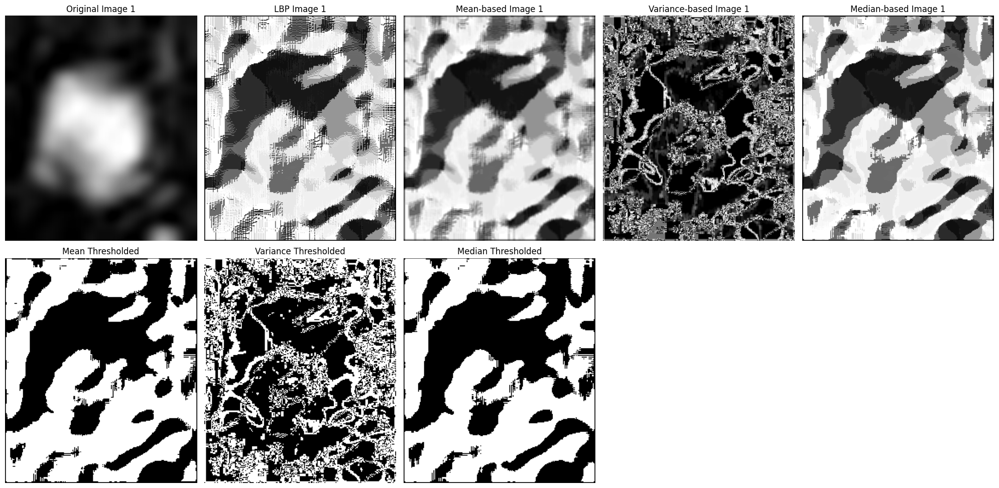

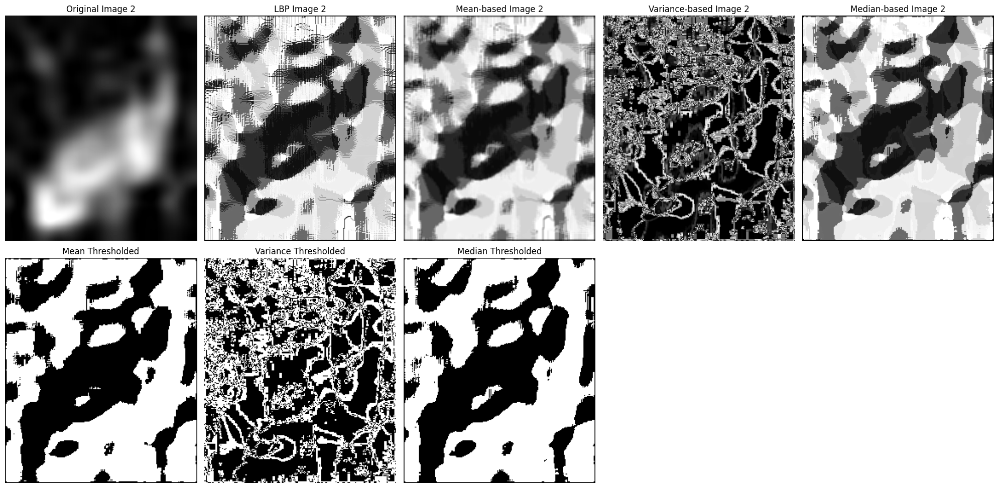

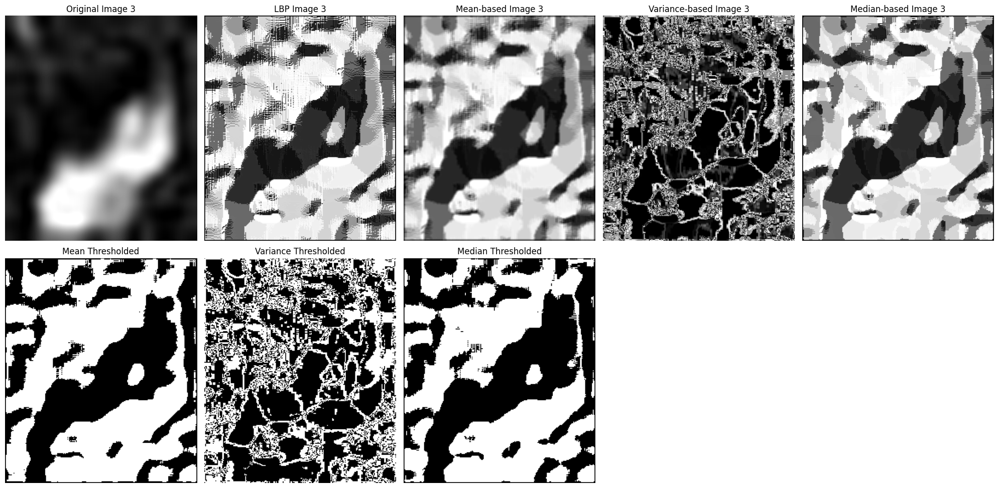

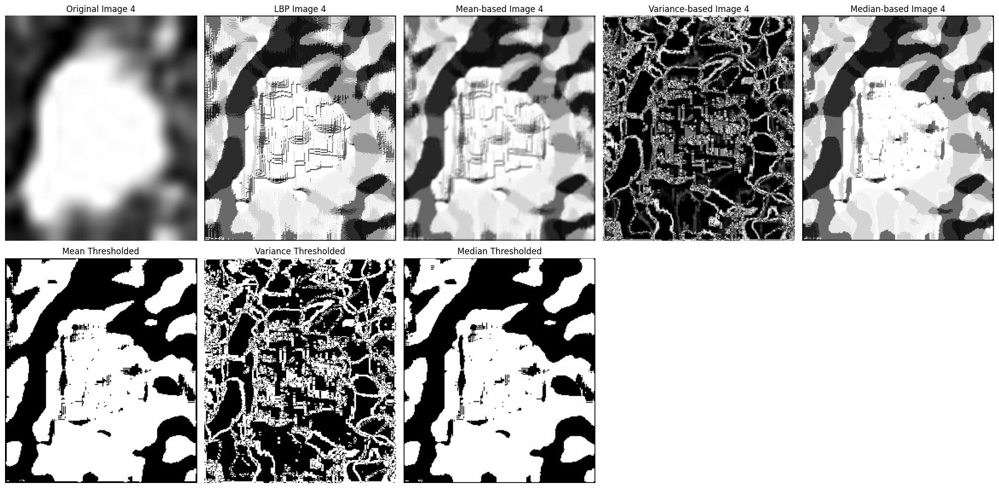

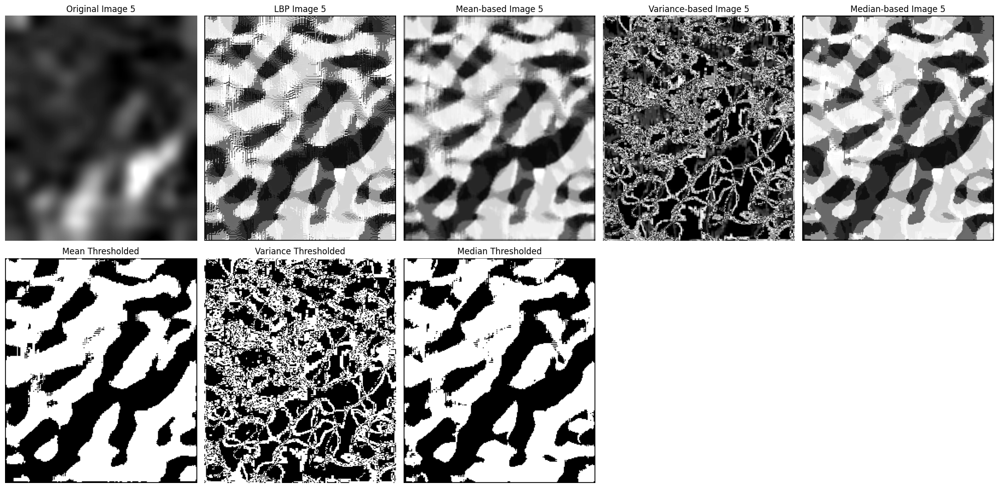

In [23]:
import numpy as np

from PIL import Image

import matplotlib.pyplot as plt

from scipy.ndimage import generic_filter

import os



# Function to normalize the image for display

def normalize_image(img_array):

    """Normalizes an image array to a range of 0-255 for better visualization."""

    min_val = np.min(img_array)

    max_val = np.max(img_array)

    normalized_img = ((img_array - min_val) / (max_val - min_val) * 255).astype(np.uint8)

    return normalized_img



# Function to compute Local Binary Pattern (LBP)

def calculate_lbp(img_array, radius=1, num_neighbors=8):

    """Computes the Local Binary Pattern (LBP) for an input image array."""

    img_height, img_width = img_array.shape

    lbp_result = np.zeros((img_height, img_width), dtype=np.uint8)



    for row in range(radius, img_height - radius):

        for col in range(radius, img_width - radius):

            center_pixel = img_array[row, col]

            binary_code = ''

            neighbor_offsets = [(dy, dx) for dy in range(-radius, radius + 1) for dx in range(-radius, radius + 1) if dy != 0 or dx != 0]

            for dy, dx in neighbor_offsets[:num_neighbors]:

                binary_code += '1' if img_array[row + dy, col + dx] >= center_pixel else '0'

            lbp_result[row, col] = int(binary_code, 2)



    return lbp_result



# Functions for computing local statistics

def compute_local_mean(input_img, window_size=3):

    """Calculates the local mean with a sliding window."""

    return generic_filter(input_img, np.mean, size=window_size)



def compute_local_variance(input_img, window_size=3):

    """Calculates the local variance with a sliding window."""

    return generic_filter(input_img, np.var, size=window_size)



def compute_local_median(input_img, window_size=3):

    """Calculates the local median with a sliding window."""

    return generic_filter(input_img, np.median, size=window_size)



# Function to apply a threshold using the MVM approach

def apply_mvm_threshold(input_img):

    """Applies a binary threshold based on the mean value of the input image."""

    mean_threshold = np.mean(input_img)

    binary_img = (input_img > mean_threshold) * 255

    return binary_img.astype(np.uint8)



# List of image paths (update with actual paths)

image_file_paths = [

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-044.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB2/p-045.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB6/p-041.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB6/p-045.jpg'

]




# Directory to save output images

output_directory = "processed_images"

os.makedirs(output_directory, exist_ok=True)



# Process each image

for img_index, file_path in enumerate(image_file_paths, start=1):

    # Load and resize the image with Lanczos filter for high-quality resizing

    input_image = Image.open(file_path).convert('L')

    target_width = 225

    aspect_ratio = input_image.height / input_image.width

    target_height = int(target_width * aspect_ratio)

    resized_image = input_image.resize((target_width, target_height), Image.LANCZOS)

    image_array = np.array(resized_image)



    # Compute LBP image

    lbp_result = calculate_lbp(image_array, radius=1, num_neighbors=8)



    # Apply mean, variance, and median transformations to the LBP image

    mean_based_img = compute_local_mean(lbp_result, window_size=3)

    variance_based_img = compute_local_variance(lbp_result, window_size=3)

    median_based_img = compute_local_median(lbp_result, window_size=3)



    # Normalize images for visualization

    mean_based_img_normalized = normalize_image(mean_based_img)

    variance_based_img_normalized = normalize_image(variance_based_img)

    median_based_img_normalized = normalize_image(median_based_img)



    # Apply MVM thresholding

    mean_thresholded_img = apply_mvm_threshold(mean_based_img_normalized)

    variance_thresholded_img = apply_mvm_threshold(variance_based_img_normalized)

    median_thresholded_img = apply_mvm_threshold(median_based_img_normalized)



    # Display images using matplotlib

    plt.figure(figsize=(20, 10))



    # Display the original resized image

    plt.subplot(2, 5, 1)

    plt.title(f"Original Image {img_index}")

    plt.imshow(image_array, cmap='gray')

    plt.axis('off')



    # Display LBP result

    plt.subplot(2, 5, 2)

    plt.title(f"LBP Image {img_index}")

    plt.imshow(lbp_result, cmap='gray')

    plt.axis('off')



    # Display mean-based transformed image

    plt.subplot(2, 5, 3)

    plt.title(f"Mean-based Image {img_index}")

    plt.imshow(mean_based_img_normalized, cmap='gray')

    plt.axis('off')



    # Display variance-based transformed image

    plt.subplot(2, 5, 4)

    plt.title(f"Variance-based Image {img_index}")

    plt.imshow(variance_based_img_normalized, cmap='gray')

    plt.axis('off')



    # Display median-based transformed image

    plt.subplot(2, 5, 5)

    plt.title(f"Median-based Image {img_index}")

    plt.imshow(median_based_img_normalized, cmap='gray')

    plt.axis('off')



    # Display thresholded mean-based image

    plt.subplot(2, 5, 6)

    plt.title("Mean Thresholded")

    plt.imshow(mean_thresholded_img, cmap='gray')

    plt.axis('off')



    # Display thresholded variance-based image

    plt.subplot(2, 5, 7)

    plt.title("Variance Thresholded")

    plt.imshow(variance_thresholded_img, cmap='gray')

    plt.axis('off')



    # Display thresholded median-based image

    plt.subplot(2, 5, 8)

    plt.title("Median Thresholded")

    plt.imshow(median_thresholded_img, cmap='gray')

    plt.axis('off')



    plt.tight_layout()

    plt.show()


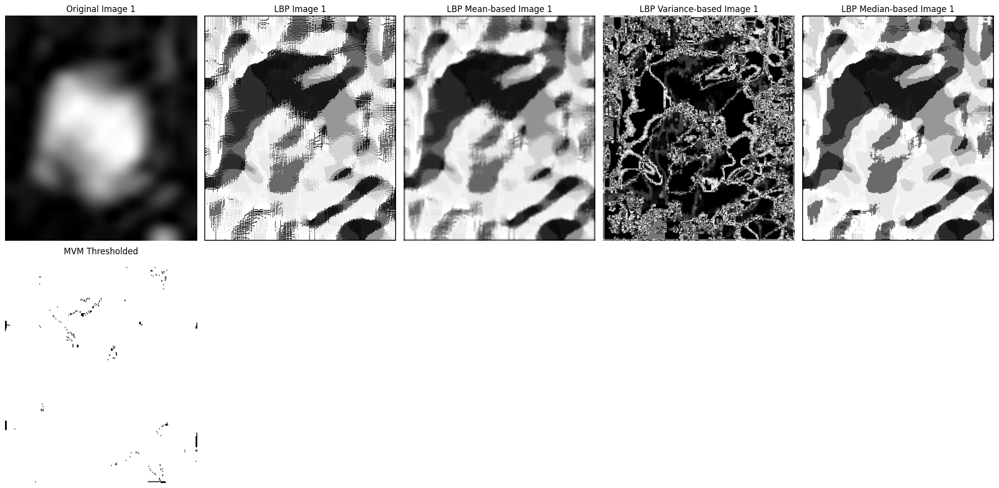

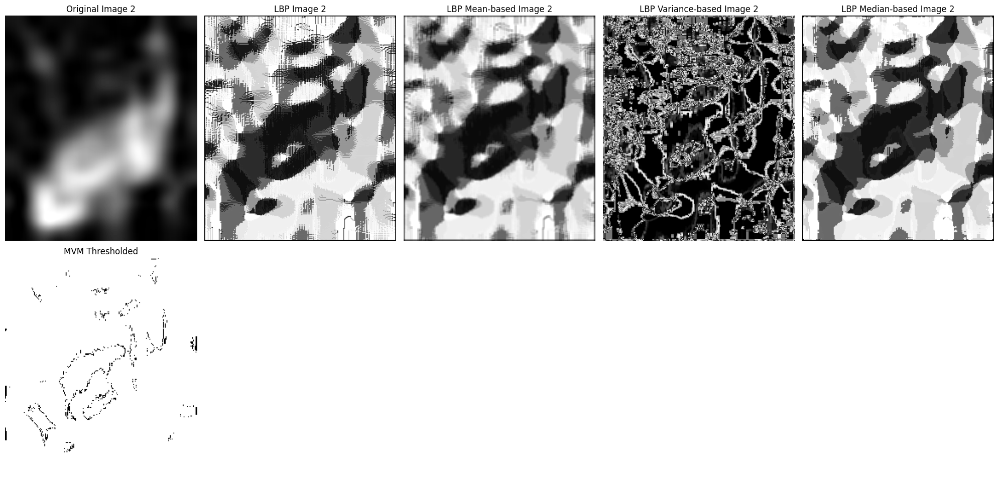

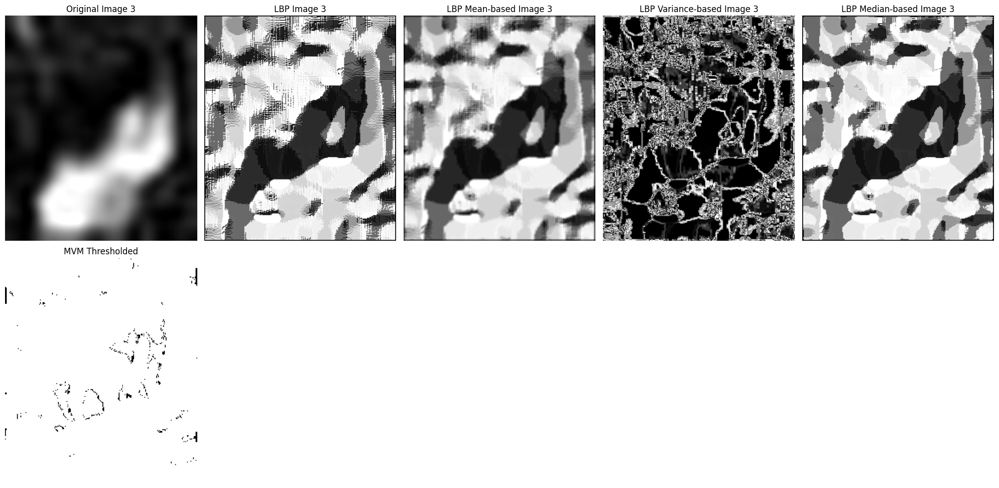

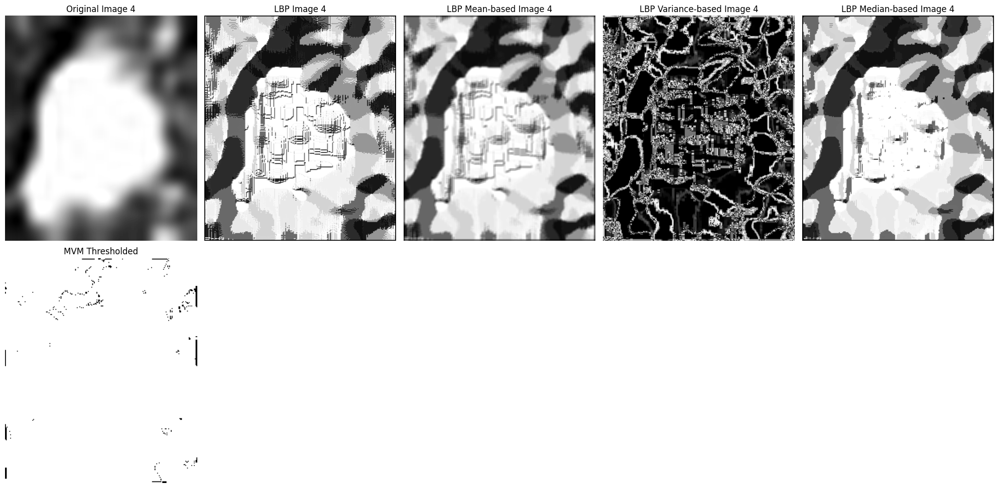

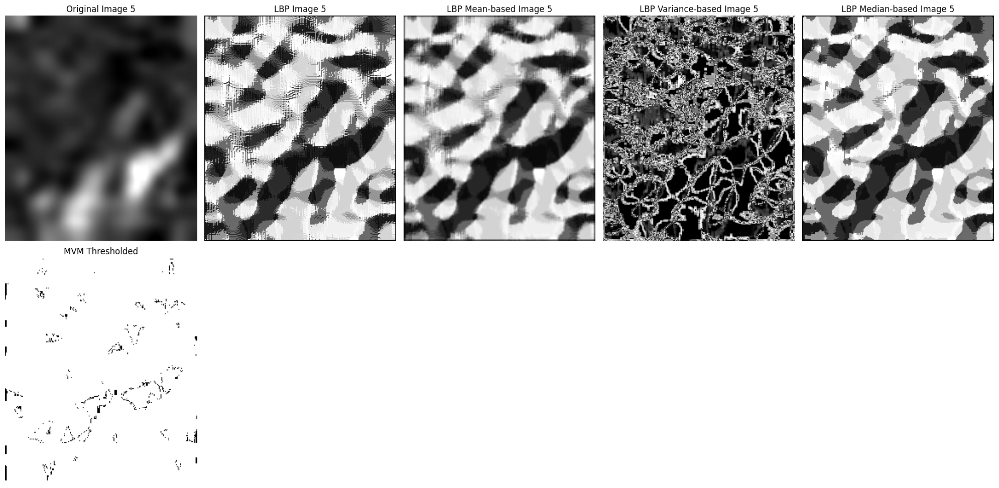

In [24]:
# This script processes images by applying Local Binary Pattern (LBP) analysis,

# computing local mean, variance, and median, and applying an MVM threshold.



import numpy as np

from PIL import Image

import matplotlib.pyplot as plt

from scipy.ndimage import generic_filter

import os



# Function to normalize the image for display

def normalize_image(image):

    image_min = np.min(image)

    image_max = np.max(image)

    if image_max == image_min:

        return image  # Avoid division by zero; return the image as is

    normalized_image = ((image - image_min) / (image_max - image_min) * 255).astype(np.uint8)

    return normalized_image



# Function to compute Local Binary Pattern (LBP)

def compute_lbp(image, radius=1, neighbors=8):

    height, width = image.shape

    lbp_image = np.zeros((height, width), dtype=np.uint8)



    for i in range(radius, height - radius):

        for j in range(radius, width - radius):

            center_pixel = image[i, j]

            binary_string = ''

            offsets = [(dy, dx) for dy in range(-radius, radius+1) for dx in range(-radius, radius+1) if dy != 0 or dx != 0]

            for dy, dx in offsets[:neighbors]:  # Take only specified neighbors

                binary_string += '1' if image[i + dy, j + dx] >= center_pixel else '0'

            lbp_image[i, j] = int(binary_string, 2)



    return lbp_image



# Define functions to compute local mean, variance, and median

def local_mean(image, size=3):

    return generic_filter(image, np.mean, size=size)



def local_variance(image, size=3):

    return generic_filter(image, np.var, size=size)



def local_median(image, size=3):

    return generic_filter(image, np.median, size=size)



# Apply MVM threshold using the formula

def apply_mvm_threshold(mean_image, variance_image, median_image):

    threshold = (mean_image + np.sqrt(variance_image) + median_image) / 3

    binary_image = (mean_image > threshold) * 255  # Apply threshold to the mean image

    return binary_image.astype(np.uint8)



# List of image paths (use os.path.join for cross-platform paths)

image_paths = [

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-044.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB2/p-045.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB6/p-041.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB6/p-045.jpg'

]


# Directory to save output images

output_dir = "output_images"

os.makedirs(output_dir, exist_ok=True)



# Process each image in the list

for idx, image_path in enumerate(image_paths, start=1):

    # Load and resize image using Lanczos filter for high quality

    image = Image.open(image_path).convert('L')

    new_width = 225

    aspect_ratio = image.height / image.width

    new_height = int(new_width * aspect_ratio)

    image_resized = image.resize((new_width, new_height), Image.LANCZOS)

    image_array = np.array(image_resized)



    # Compute LBP image

    lbp_image = compute_lbp(image_array, radius=1, neighbors=8)



    # Apply mean, variance, and median transformations to LBP image

    lbp_mean_based = local_mean(lbp_image, size=3)

    lbp_variance_based = local_variance(lbp_image, size=3)

    lbp_median_based = local_median(lbp_image, size=3)



    # Normalize for better display

    lbp_mean_based = normalize_image(lbp_mean_based)

    lbp_variance_based = normalize_image(lbp_variance_based)

    lbp_median_based = normalize_image(lbp_median_based)



    # Apply MVM threshold using the formula

    mvm_thresholded = apply_mvm_threshold(lbp_mean_based, lbp_variance_based, lbp_median_based)



    # Display the images

    plt.figure(figsize=(20, 10))



    # Display original resized image

    plt.subplot(2, 5, 1)

    plt.title(f"Original Image {idx}")

    plt.imshow(image_array, cmap='gray')

    plt.axis('off')



    # Display LBP image

    plt.subplot(2, 5, 2)

    plt.title(f"LBP Image {idx}")

    plt.imshow(lbp_image, cmap='gray')

    plt.axis('off')



    # Display LBP mean-based image

    plt.subplot(2, 5, 3)

    plt.title(f"LBP Mean-based Image {idx}")

    plt.imshow(lbp_mean_based, cmap='gray')

    plt.axis('off')



    # Display LBP variance-based image

    plt.subplot(2, 5, 4)

    plt.title(f"LBP Variance-based Image {idx}")

    plt.imshow(lbp_variance_based, cmap='gray')

    plt.axis('off')



    # Display LBP median-based image

    plt.subplot(2, 5, 5)

    plt.title(f"LBP Median-based Image {idx}")

    plt.imshow(lbp_median_based, cmap='gray')

    plt.axis('off')



    # Display MVM thresholded image

    plt.subplot(2, 5, 6)

    plt.title("MVM Thresholded")

    plt.imshow(mvm_thresholded, cmap='gray')

    plt.axis('off')



    plt.tight_layout()

    plt.show()


In [ ]:
#

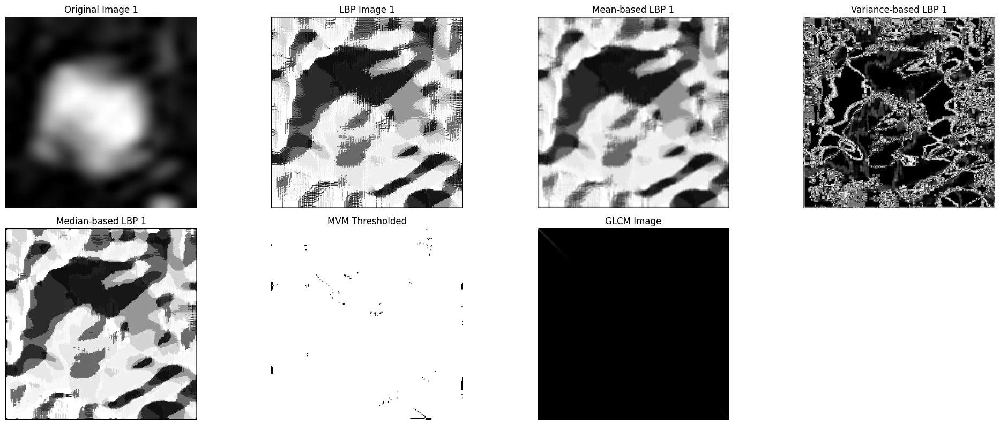

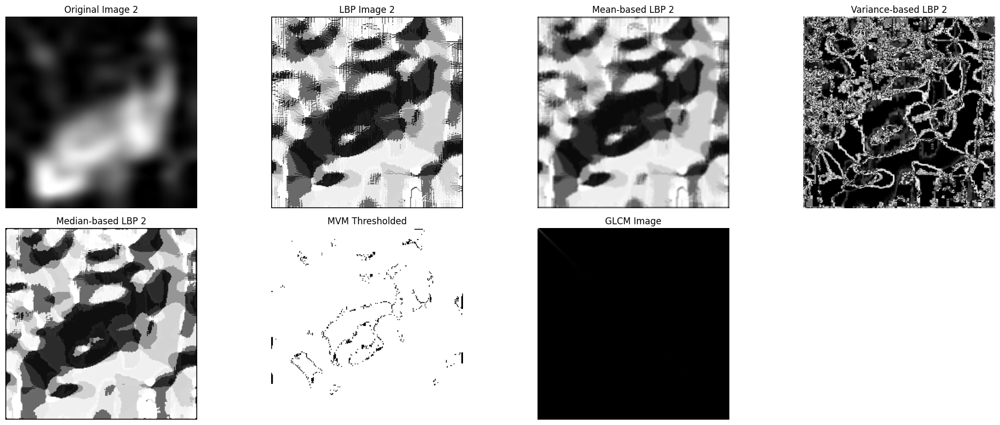

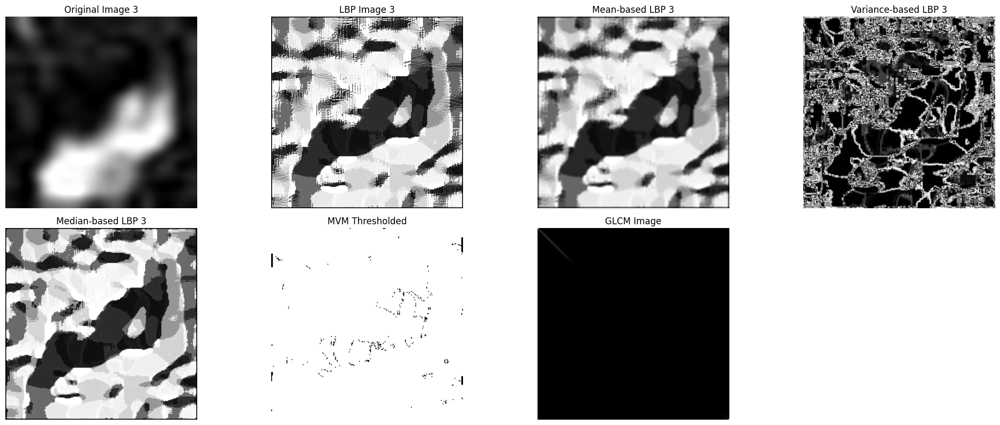

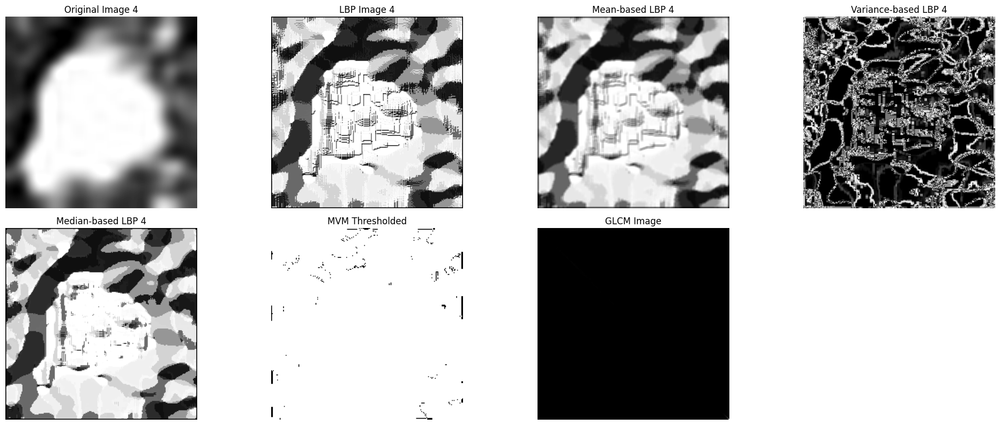

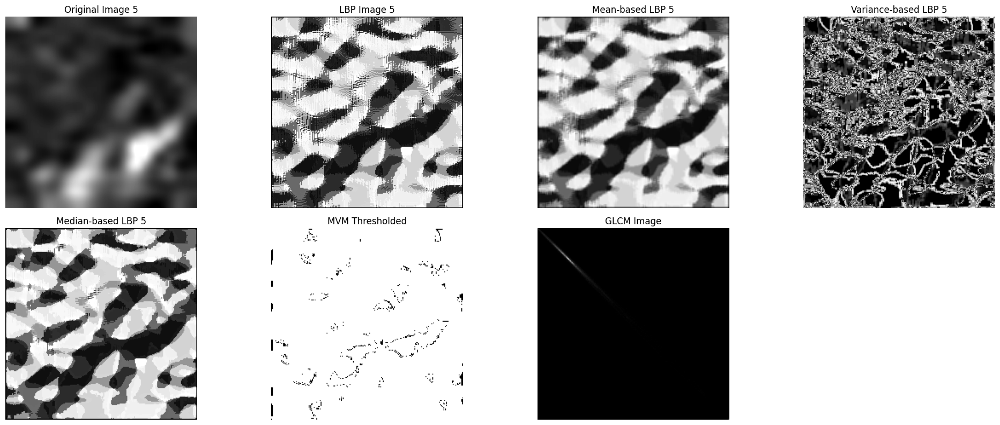

In [25]:
# Image processing script to compute Local Binary Pattern (LBP) and Gray Level Co-occurrence Matrix (GLCM) features

# Applies various transformations and thresholds for image analysis.



import numpy as np

from PIL import Image

import matplotlib.pyplot as plt

from scipy.ndimage import generic_filter

import os



# Function to normalize the image for display

def normalize_image(image):

    """Normalize image pixel values to the range [0, 255]."""

    min_value = np.min(image)

    max_value = np.max(image)

    normalized_image = ((image - min_value) / (max_value - min_value) * 255).astype(np.uint8)

    return normalized_image



# Function to compute Local Binary Pattern (LBP)

def compute_lbp(image_array, radius=1, num_neighbors=8):

    """Compute the Local Binary Pattern (LBP) for an input image."""

    height, width = image_array.shape

    lbp_result = np.zeros((height, width), dtype=np.uint8)



    for row in range(radius, height - radius):

        for col in range(radius, width - radius):

            center_pixel = image_array[row, col]

            binary_code = ''

            neighbors_offsets = [(dy, dx) for dy in range(-radius, radius + 1) for dx in range(-radius, radius + 1) if dy != 0 or dx != 0]

            for dy, dx in neighbors_offsets[:num_neighbors]:  # Use only the specified number of neighbors

                binary_code += '1' if image_array[row + dy, col + dx] >= center_pixel else '0'

            lbp_result[row, col] = int(binary_code, 2)



    return lbp_result



# Define functions to compute local statistics (mean, variance, median)

def compute_local_mean(image_array, kernel_size=3):

    """Compute local mean of the image using a sliding window."""

    return generic_filter(image_array, np.mean, size=kernel_size)



def compute_local_variance(image_array, kernel_size=3):

    """Compute local variance of the image using a sliding window."""

    return generic_filter(image_array, np.var, size=kernel_size)



def compute_local_median(image_array, kernel_size=3):

    """Compute local median of the image using a sliding window."""

    return generic_filter(image_array, np.median, size=kernel_size)



# Apply Multi-Variable Merging (MVM) threshold using the formula

def apply_mvm_threshold(mean_img, variance_img, median_img):

    """Apply threshold based on the mean, variance, and median images."""

    combined_threshold = (mean_img + np.sqrt(variance_img) + median_img) / 3

    binary_image = (mean_img > combined_threshold) * 255  # Apply threshold to the mean image

    return binary_image.astype(np.uint8)



# Function to compute GLCM and extract normalized feature image

def compute_glcm(image_array, distance=1, angle=0):

    """Compute Gray Level Co-occurrence Matrix (GLCM) for texture analysis."""

    max_gray_level = 256  # Assuming 8-bit images

    glcm_matrix = np.zeros((max_gray_level, max_gray_level), dtype=np.int32)



    dx = int(np.round(np.cos(angle) * distance))

    dy = int(np.round(np.sin(angle) * distance))



    for row in range(image_array.shape[0] - dy):

        for col in range(image_array.shape[1] - dx):

            pixel_row = image_array[row, col]

            pixel_col = image_array[row + dy, col + dx]

            glcm_matrix[pixel_row, pixel_col] += 1



    return glcm_matrix



# List of image paths (update with your specific paths)

image_file_paths = [

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-041.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB1/p-044.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB2/p-045.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB6/p-041.jpg',

    '/kaggle/input/mri-dataset/Dataset_MRI/test/Malignant/BreaDM-Ma-1801/SUB6/p-045.jpg'

]




# Create a directory to save processed images

output_directory = "output_images"

os.makedirs(output_directory, exist_ok=True)



# Process each image in the list

for image_index, image_path in enumerate(image_file_paths, start=1):

    # Load and resize the image with a high-quality filter

    image = Image.open(image_path).convert('L')

    resized_dimensions = (225, 225)

    resized_image = image.resize(resized_dimensions, Image.LANCZOS)

    image_array = np.array(resized_image)



    # Compute LBP representation

    lbp_image = compute_lbp(image_array, radius=1, num_neighbors=8)



    # Compute local statistics for LBP image

    mean_based_lbp = compute_local_mean(lbp_image, kernel_size=3)

    variance_based_lbp = compute_local_variance(lbp_image, kernel_size=3)

    median_based_lbp = compute_local_median(lbp_image, kernel_size=3)



    # Normalize the images for visualization

    mean_based_lbp = normalize_image(mean_based_lbp)

    variance_based_lbp = normalize_image(variance_based_lbp)

    median_based_lbp = normalize_image(median_based_lbp)



    # Apply MVM thresholding

    mvm_thresholded_image = apply_mvm_threshold(mean_based_lbp, variance_based_lbp, median_based_lbp)



    # Compute and normalize GLCM

    glcm_matrix = compute_glcm(image_array, distance=1, angle=0)

    glcm_normalized = normalize_image(glcm_matrix)



    # Display the processed images

    plt.figure(figsize=(20, 12))



    # Display original image

    plt.subplot(3, 4, 1)

    plt.title(f"Original Image {image_index}")

    plt.imshow(image_array, cmap='gray')

    plt.axis('off')



    # Display LBP image

    plt.subplot(3, 4, 2)

    plt.title(f"LBP Image {image_index}")

    plt.imshow(lbp_image, cmap='gray')

    plt.axis('off')



    # Display mean-based LBP image

    plt.subplot(3, 4, 3)

    plt.title(f"Mean-based LBP {image_index}")

    plt.imshow(mean_based_lbp, cmap='gray')

    plt.axis('off')



    # Display variance-based LBP image

    plt.subplot(3, 4, 4)

    plt.title(f"Variance-based LBP {image_index}")

    plt.imshow(variance_based_lbp, cmap='gray')

    plt.axis('off')



    # Display median-based LBP image

    plt.subplot(3, 4, 5)

    plt.title(f"Median-based LBP {image_index}")

    plt.imshow(median_based_lbp, cmap='gray')

    plt.axis('off')



    # Display MVM thresholded image

    plt.subplot(3, 4, 6)

    plt.title("MVM Thresholded")

    plt.imshow(mvm_thresholded_image, cmap='gray')

    plt.axis('off')



    # Display GLCM matrix as an image

    plt.subplot(3, 4, 7)

    plt.title("GLCM Image")

    plt.imshow(glcm_normalized, cmap='gray')

    plt.axis('off')



    plt.tight_layout()

    plt.show()
